# Temp Derivatives, US 13 stations


The daily average temperature in **CME** is measured as **the average of the daily minimum and maximum temperature**.

Notice these are actually avg of "block maxima" (BM) rather than discrete averages like (sum of Temp measurements)/ (num of measurements in a day).

BM are in the focus of extreme statistics: BM in stock markets has strong fat tails and are extremely exciting for financial engrs.

For mild stochastic processes like temperature, BM still has some unpredictabilities for us to play with, and the upper tail (due to global warming) can be unpredictable and profitable.

- univariate extremes
  1. baseline
     trend: polynomial (1st linear; 2nd quadaratic); LSE
     seasonality: fft; wavelet; LSE
  2. residuals: max/min/avg
- multivariate dependence (residuals)
  1. corr: vine
  2. tail dependence


# pickle


In [49]:
import sys
import os
import pickle

currentdir = os.getcwd()

sys.path.append(os.path.join(currentdir, "script/wxderivs"))

from wxderivs import DIR_WORK

file_in = os.path.normpath(os.path.join(DIR_WORK, "../../out", "res_CDD_HDD.pkl"))
with open(file_in, "rb") as f:
    data_in = pickle.load(f)
print(data_in.keys())
dct_fit_res = data_in["dct_fit_res"]
df_evi_all = data_in["df_evi_all"]

dict_keys(['df_avg_all', 'df_max_all', 'df_min_all', 'dct_fit_res', 'df_y', 'df_y_pred', 'df_res', 'df_std', 'df_res_scaled', 'df_cdd', 'df_cdd_pred', 'df_cdd_res', 'df_hdd', 'df_hdd_pred', 'df_hdd_res', 'df_evi_all'])


In [1]:
import sys

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy.fft as fft
import seaborn as sns
import torch
from scipy.stats import genextreme, genpareto, pareto
from wxderivs import (
    DIR_WORK,
    MONTH_CDD,
    MONTH_HDD,
    SET_CDD,
    SET_HDD,
    SET_USA,
    dct_name_file,
    fit_mean_std,
)

sys.path.append(str(DIR_WORK / "unibm"))

import unibm
import unibm.benchmark

0 TOKYO
1 Portland International Airport
2 Dallas-Fort Worth International Airport
3 Atlanta-Hartsfield International Airport
4 Cincinnati-Northern Kentucky International Airport
5 Houston-George Bush Intercontinental Airport
6 Burbank-Glendale-Pasadena Airport
7 LONDON HEATHROW
8 PARIS ORLY
9 ESSEN
10 Chicago OHare International Airport
11 Sacramento Executive Airport
12 Boston-Logan International Airport
13 New York LaGuardia Airport
14 Philadelphia International Airport
15 Las Vegas Mccarran Airport
16 Minneapolis-Saint Paul International Airport
17 AMSTERDAM SCHIPHOL


In [2]:
df_max_all = {}
df_min_all = {}

for name in SET_USA:
    tmp_df = pd.read_csv(dct_name_file[name])
    tmp_df.index = pd.to_datetime(tmp_df["DATE"])
    df_max_all[name] = tmp_df["DAILY_MAX_TEMP"]
    df_min_all[name] = tmp_df["DAILY_MIN_TEMP"]
df_max_all = pd.DataFrame(df_max_all)
df_min_all = pd.DataFrame(df_min_all)
df_avg_all = (df_max_all + df_min_all) / 2
df_y = df_avg_all
df_max_all.head()

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
DATE,,,,,,,,,,,,,
2014-01-01,66.0,29.0,22.0,65.0,47.0,47.0,41.0,77.0,44.0,69.0,62.0,1.0,33.0
2014-01-02,64.0,26.0,21.0,59.0,39.0,52.0,35.0,84.0,47.0,43.0,67.0,4.0,32.0
2014-01-03,61.0,14.0,20.0,54.0,18.0,36.0,22.0,76.0,48.0,52.0,66.0,29.0,19.0
2014-01-04,63.0,27.0,31.0,66.0,38.0,36.0,29.0,72.0,42.0,70.0,68.0,35.0,28.0
2014-01-05,57.0,38.0,29.0,65.0,48.0,52.0,53.0,78.0,49.0,50.0,66.0,-2.0,50.0


# EDA: viz of max, min, avg, (max-min); all 13 US city


In [3]:
def plot_day_of_year(
    srs,
    is_day_of_year_frac=False,
    is_scatter=False,
    alpha=0.7,
    is_label=False,
    xlabel="Day of year",
    ylabel="Temperature",
    title="Temperature vs Day of year",
    axhline=[
        65,
    ],
    axvline_red=pd.DatetimeIndex(["2020-05-01", "2020-09-30"]).day_of_year.to_list(),
    axvline_blue=pd.DatetimeIndex(["2020-11-01", "2020-03-31"]).day_of_year.to_list(),
    ax=None,
):
    if is_day_of_year_frac:
        vec_t = (srs.index.day_of_year / (srs.index.is_leap_year + 365)).to_numpy()
    else:
        vec_t = srs.index.day_of_year.to_numpy()
    vec_y = srs.to_numpy()
    year_unique = srs.index.year.unique()
    cmap = plt.get_cmap("rainbow", len(year_unique))
    color_map = {year: cmap(i) for i, year in enumerate(year_unique)}
    if ax is None:
        fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    for year in year_unique:
        idx = srs.index.year == year
        if is_scatter:
            ax.scatter(
                vec_t[idx],
                vec_y[idx],
                s=1,
                color=color_map[year],
                alpha=alpha,
                label=year if is_label else None,
            )
        else:
            ax.plot(
                vec_t[idx],
                vec_y[idx],
                label=year,
                alpha=alpha,
                lw=1,
                c=color_map[year],
                linestyle="-.",
            )
    if axhline:
        for _ in axhline:
            ax.axhline(_, color="black", linestyle="--", lw=0.9)
    if axvline_red:
        for _ in axvline_red:
            ax.axvline(_, color="red", linestyle="--", lw=0.9)
    if axvline_blue:
        for _ in axvline_blue:
            ax.axvline(_, color="blue", linestyle="--", lw=0.9)
    ax.grid()
    if is_label:
        ax.legend()
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    return ax

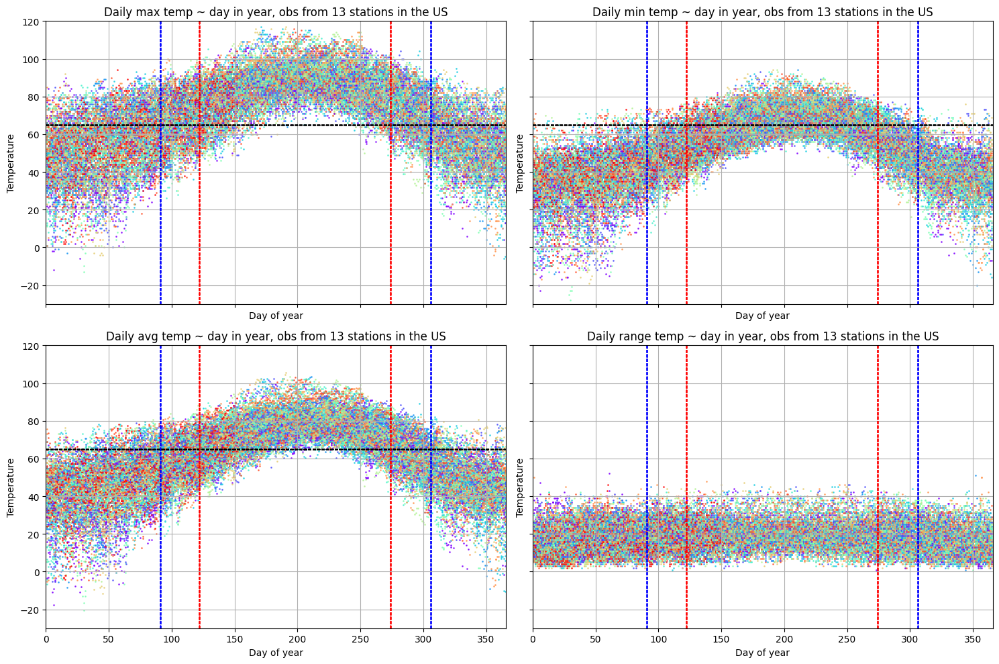

In [4]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 10), sharex=True, sharey=True)
for station in SET_USA:
    plot_day_of_year(
        df_max_all[station],
        is_scatter=True,
        title="Daily max temp ~ day in year, obs from 13 stations in the US",
        ax=axes[0, 0],
    )
    plot_day_of_year(
        df_min_all[station],
        is_scatter=True,
        title="Daily min temp ~ day in year, obs from 13 stations in the US",
        ax=axes[0, 1],
    )
    plot_day_of_year(
        (df_max_all[station] + df_min_all[station]) / 2,
        is_scatter=True,
        title="Daily avg temp ~ day in year, obs from 13 stations in the US",
        ax=axes[1, 0],
    )
    plot_day_of_year(
        df_max_all[station] - df_min_all[station],
        is_scatter=True,
        title="Daily range temp ~ day in year, obs from 13 stations in the US",
        ax=axes[1, 1],
        axhline=None,
    )
for ax in axes.flatten():
    ax.set_xlim(0, 366)
    ax.set_ylim(-30, 120)
plt.tight_layout()

# svg_file_path = 'daily_temp_plots.svg'
# plt.savefig(svg_file_path, format='svg')

> comment
>
> the spread (range) as DailyMax-DailyMin looks homoscedastic across years.


# EDA: max in CDD months, min in HDD months


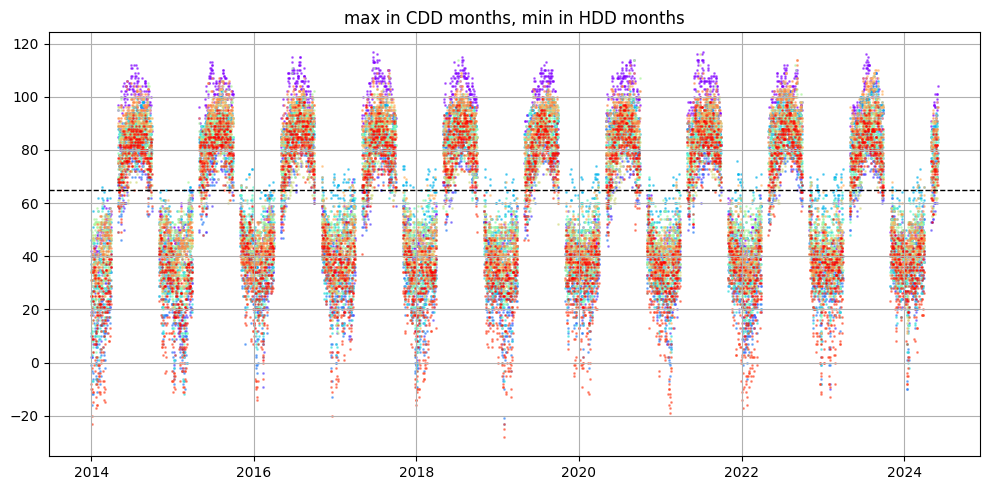

In [5]:
cmap = plt.get_cmap("rainbow", len(SET_USA))
color_map = {year: cmap(i) for i, year in enumerate(SET_USA)}
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
for station in SET_USA:
    idx = df_max_all.index.month.isin(MONTH_CDD)
    ax.scatter(
        df_max_all[idx].index,
        df_max_all[idx][station],
        s=1,
        alpha=0.5,
        color=color_map[station],
        label=f"max, CDD months, {station}",
    )
    idx = df_min_all.index.month.isin(MONTH_HDD)
    ax.scatter(
        df_min_all[idx].index,
        df_min_all[idx][station],
        s=1,
        alpha=0.5,
        color=color_map[station],
        label=f"min, HDD months, {station}",
    )
plt.axhline(65, color="black", linestyle="--", lw=1)
plt.title("max in CDD months, min in HDD months")
# plt.legend()
plt.grid()
plt.tight_layout()

# EDA: FFT power spectrum


avg temp


Text(0.5, 1.0, 'Power spectrum of daily avg temp,\nHouston-George Bush Intercontinental Airport, dominant period: 380.40 days')

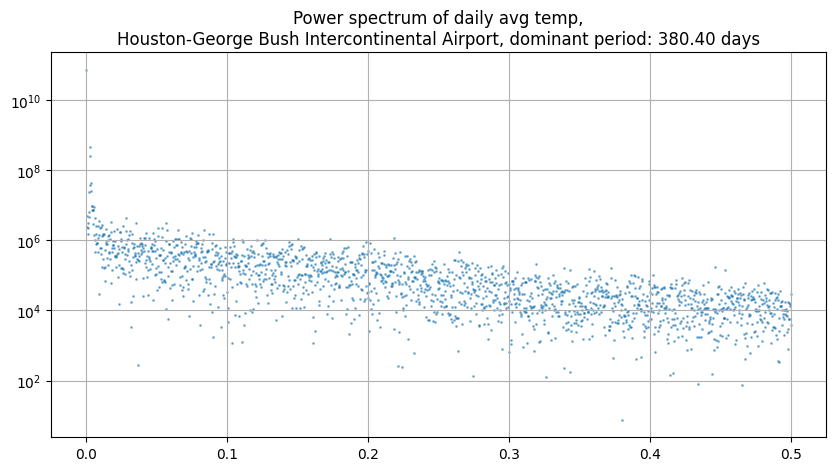

In [6]:
# for station in SET_USA:
station = "Houston-George Bush Intercontinental Airport"
tmp_df_filtered = df_avg_all[station]
# tmp_df_filtered = tmp_df_filtered.rolling(window=30).mean().dropna()
# tmp_df_filtered = tmp_df_filtered.rolling(window=30, win_type="gaussian").mean(std=30).dropna()
yf = np.square(abs(fft.rfft(tmp_df_filtered.values)))
xf = fft.rfftfreq(n=len(tmp_df_filtered), d=1)
idx = np.argmax(np.abs(yf)[1:]) + 1
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
ax.scatter(xf, np.abs(yf), s=1, alpha=0.5)
ax.set_yscale("log")
plt.grid()
plt.title(
    f"Power spectrum of daily avg temp,\n{station}, dominant period: {1 / xf[idx]:.2f} days"
)
# ! the dominant freq and period (excluding the constant term)

max temp


Text(0.5, 1.0, 'Power spectrum of daily avg temp,\nHouston-George Bush Intercontinental Airport, dominant period: 380.40 days')

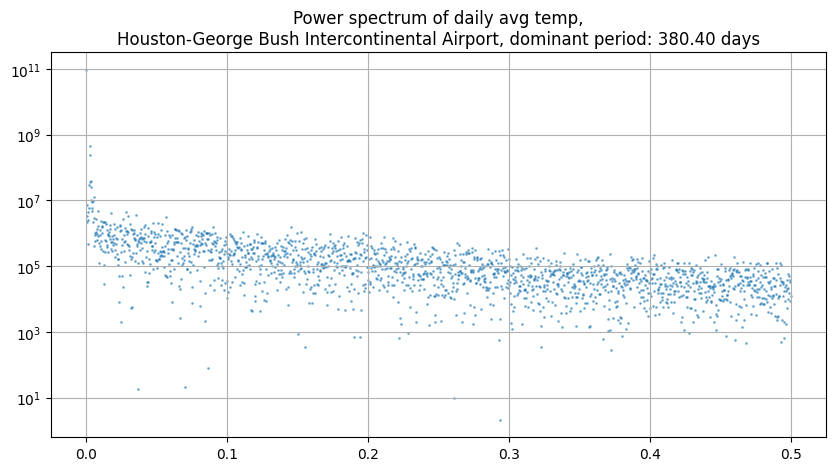

In [7]:
# for station in SET_USA:
tmp_df_filtered = df_max_all[station]
# tmp_df_filtered = tmp_df_filtered.rolling(window=30).mean().dropna()
# tmp_df_filtered = tmp_df_filtered.rolling(window=30, win_type="gaussian").mean(std=30).dropna()
yf = np.square(abs(fft.rfft(tmp_df_filtered.values)))
xf = fft.rfftfreq(n=len(tmp_df_filtered), d=1)
idx = np.argmax(np.abs(yf)[1:]) + 1
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
ax.scatter(xf, np.abs(yf), s=1, alpha=0.5)
ax.set_yscale("log")
plt.grid()
plt.title(
    f"Power spectrum of daily avg temp,\n{station}, dominant period: {1 / xf[idx]:.2f} days"
)
# ! the dominant freq and period (excluding the constant term)

min temp


Text(0.5, 1.0, 'Power spectrum of daily avg temp,\nHouston-George Bush Intercontinental Airport, dominant period: 380.40 days')

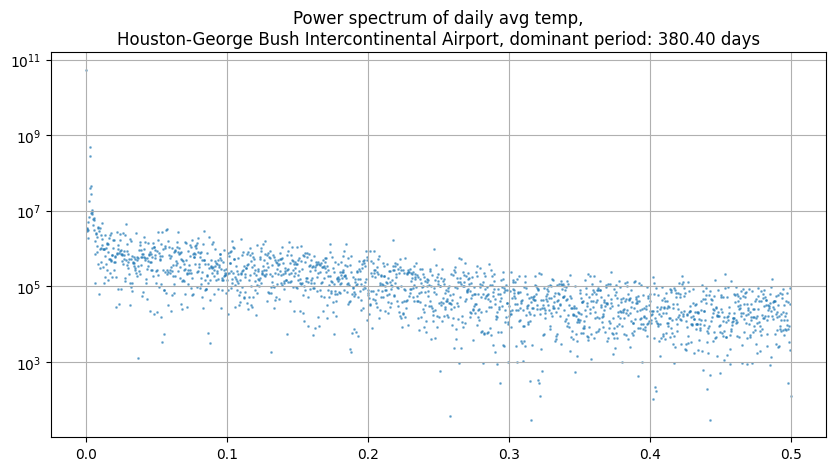

In [8]:
# for station in SET_USA:
tmp_df_filtered = df_min_all[station]
# tmp_df_filtered = tmp_df_filtered.rolling(window=30).mean().dropna()
# tmp_df_filtered = tmp_df_filtered.rolling(window=30, win_type="gaussian").mean(std=30).dropna()
yf = np.square(abs(fft.rfft(tmp_df_filtered.values)))
xf = fft.rfftfreq(n=len(tmp_df_filtered), d=1)
idx = np.argmax(np.abs(yf)[1:]) + 1
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
ax.scatter(xf, np.abs(yf), s=1, alpha=0.5)
ax.set_yscale("log")
plt.grid()
plt.title(
    f"Power spectrum of daily avg temp,\n{station}, dominant period: {1 / xf[idx]:.2f} days"
)
# ! the dominant freq and period (excluding the constant term)

# Univariate Extremes


## baseline and seasonality: Avg Temp


In [9]:
dct_fit_res = {}
for station in SET_USA:
    dct_fit_res[station] = fit_mean_std(
        srs=(df_max_all[station] + df_min_all[station]) / 2
    )

/workspaces/Weather-Derivatives-Pricing/script/wxderivs/__init__.py:119: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  + alpha * vec_res[i - 1] ** 2
/workspaces/Weather-Derivatives-Pricing/script/wxderivs/__init__.py:120: RuntimeWarning: overflow encountered in scalar power
  + beta * vec_variance[i - 1] ** 2
/home/codespace/.local/lib/python3.12/site-packages/scipy/optimize/_slsqp_py.py:434: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  fx = wrapped_fun(x)
/home/codespace/.local/lib/python3.12/site-packages/scipy/optimize/_slsqp_py.py:438: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  g = append(wrapped_grad(x), 0.0)
/home/codespace/.local/lib/python3.12/site-packages/scipy/optimize/_slsqp_py.py:498: Runtime

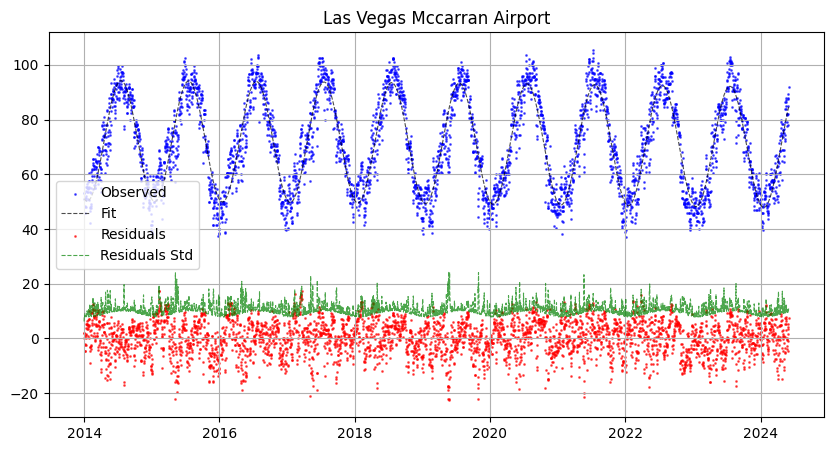

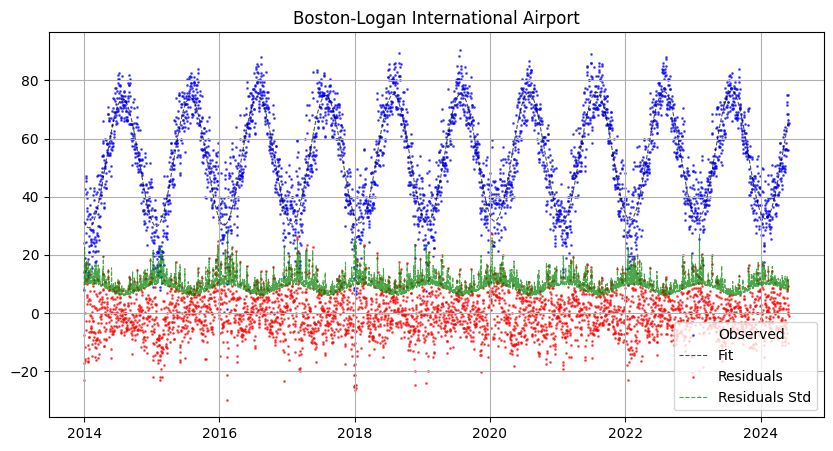

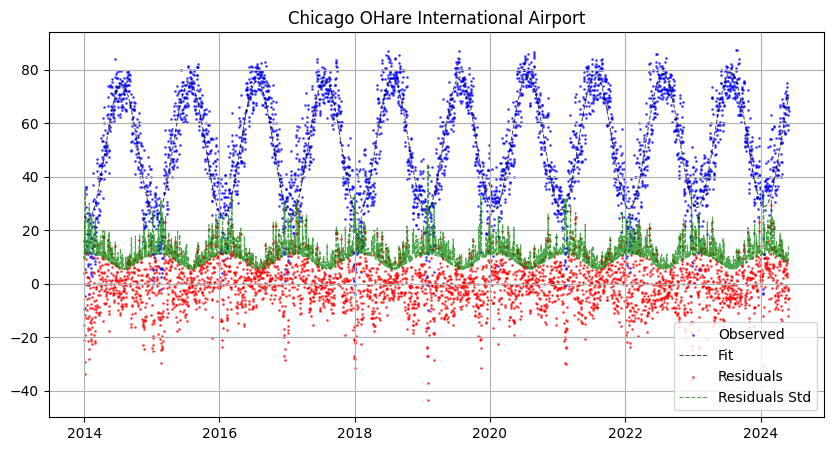

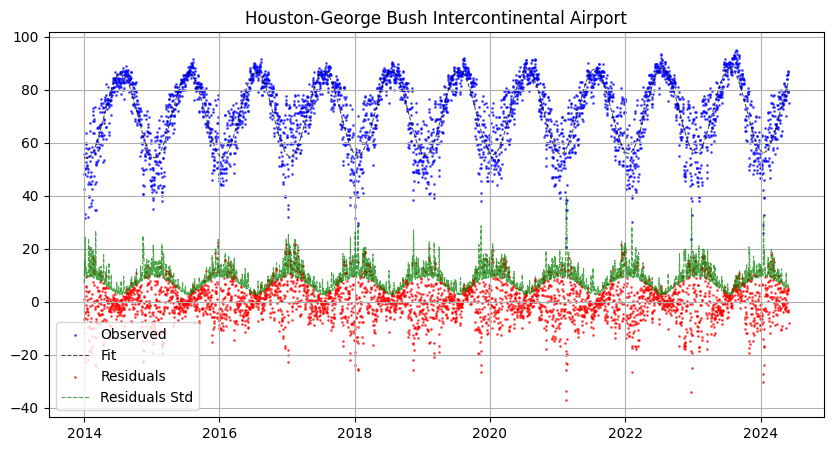

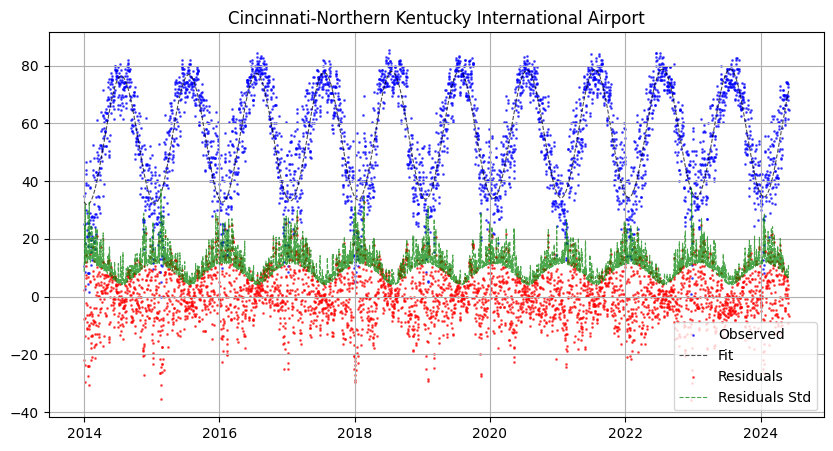

...

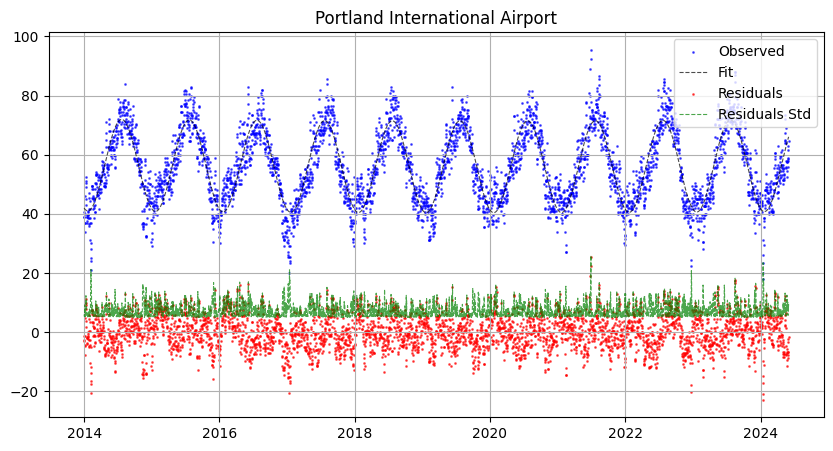

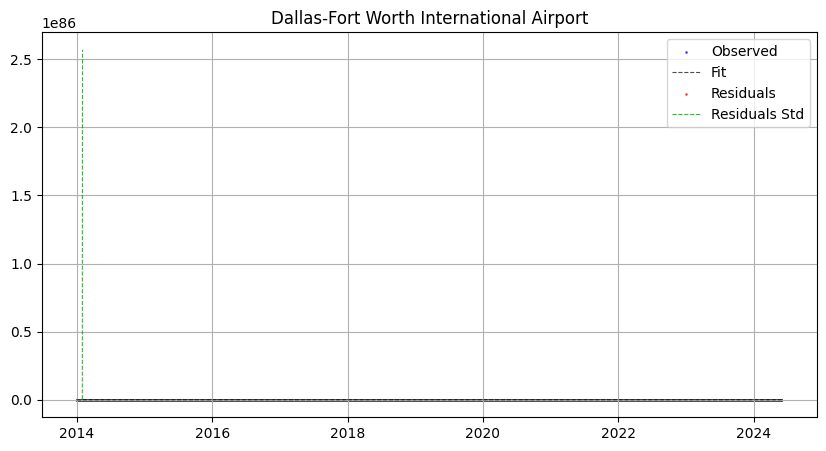

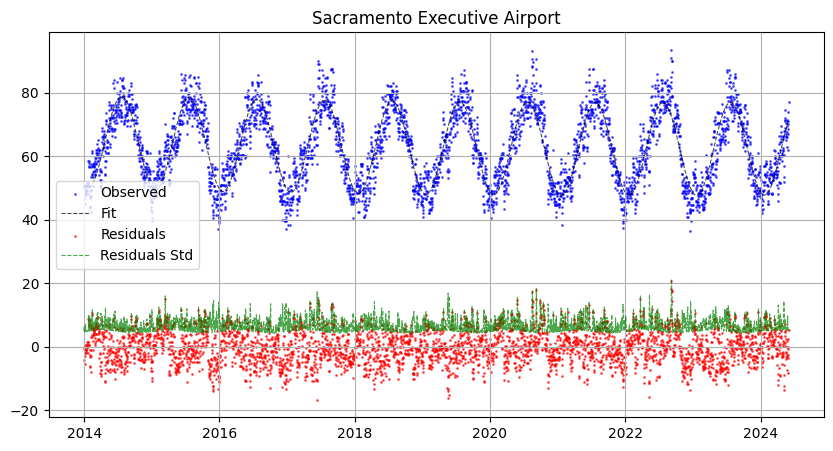

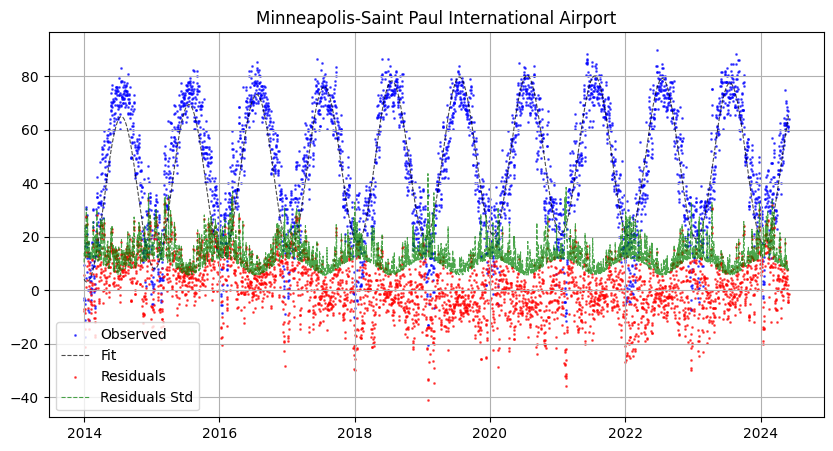

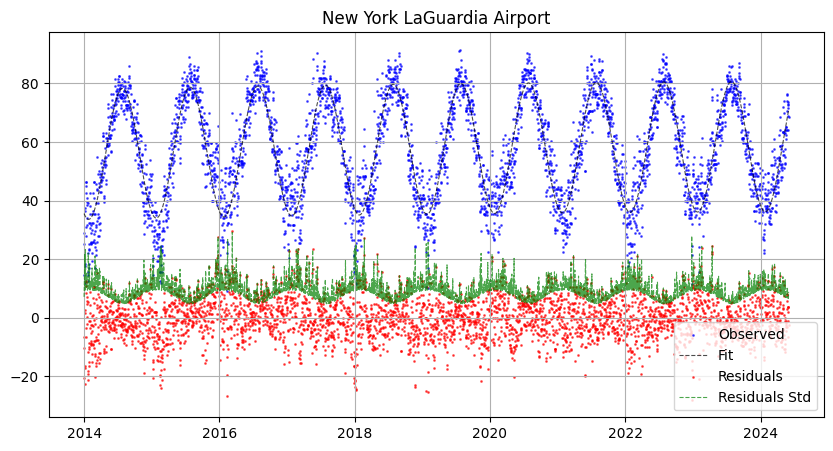

In [10]:
for station in SET_USA:
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    ax.set_title(f"{station}")
    ax.scatter(
        x=dct_fit_res[station]["vec_index"],
        y=dct_fit_res[station]["vec_y"],
        s=1,
        color="blue",
        alpha=0.6,
        label="Observed",
    )
    ax.plot(
        dct_fit_res[station]["vec_index"],
        dct_fit_res[station]["vec_y_pred"],
        linewidth=0.8,
        alpha=0.7,
        label="Fit",
        color="black",
        linestyle="--",
    )
    ax.scatter(
        x=dct_fit_res[station]["vec_index"],
        y=dct_fit_res[station]["vec_res"],
        s=1,
        color="red",
        alpha=0.6,
        label="Residuals",
    )
    ax.plot(
        dct_fit_res[station]["vec_index"],
        dct_fit_res[station]["vec_std"],
        linewidth=0.8,
        alpha=0.7,
        label="Residuals Std",
        color="green",
        linestyle="--",
    )
    ax.grid(True)
    ax.legend()
    
    if station == "New York LaGuardia Airport":
        plt.savefig("New_York_LaGuardia_Airport.svg", format='svg')

## show rescaled std.dev.

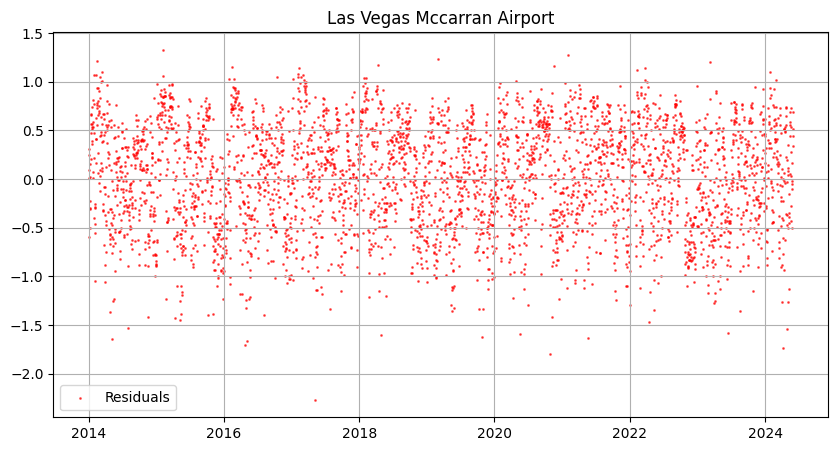

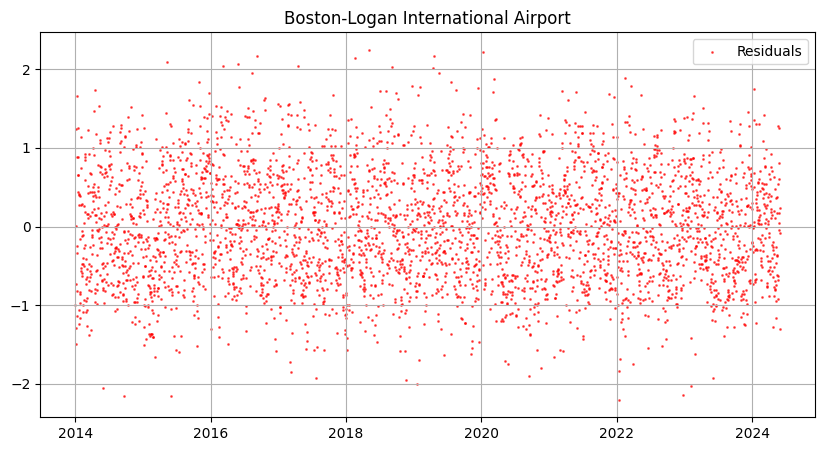

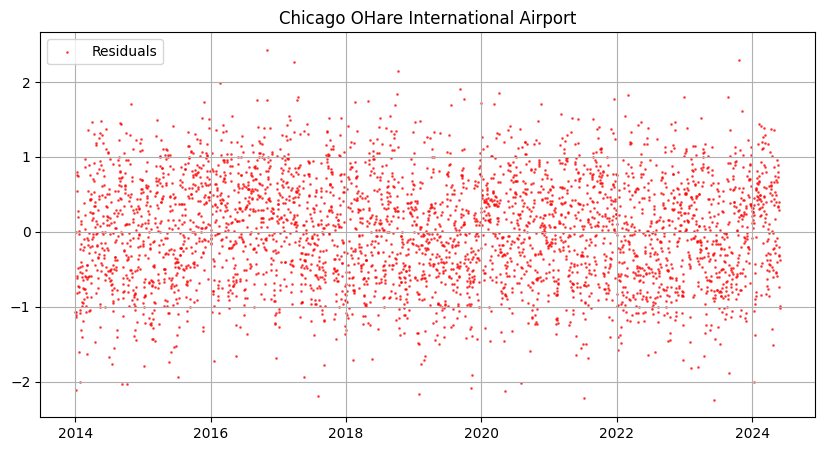

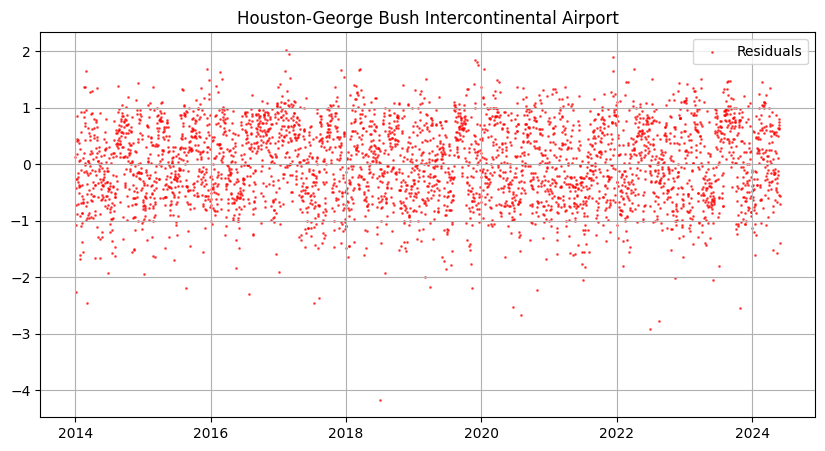

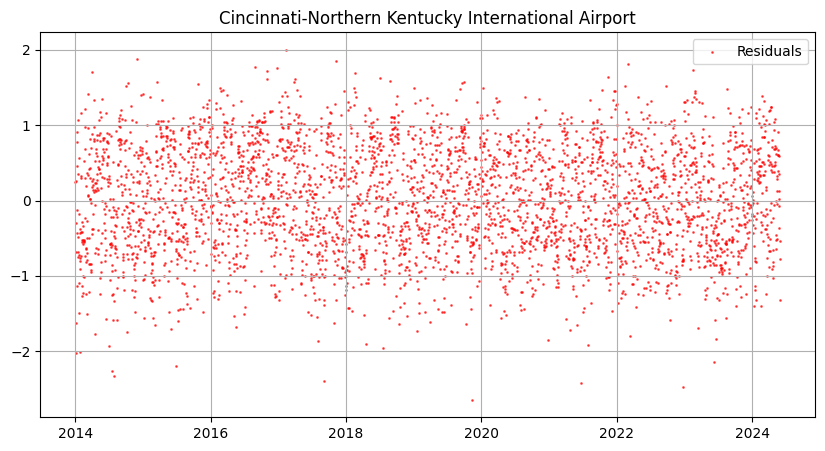

...

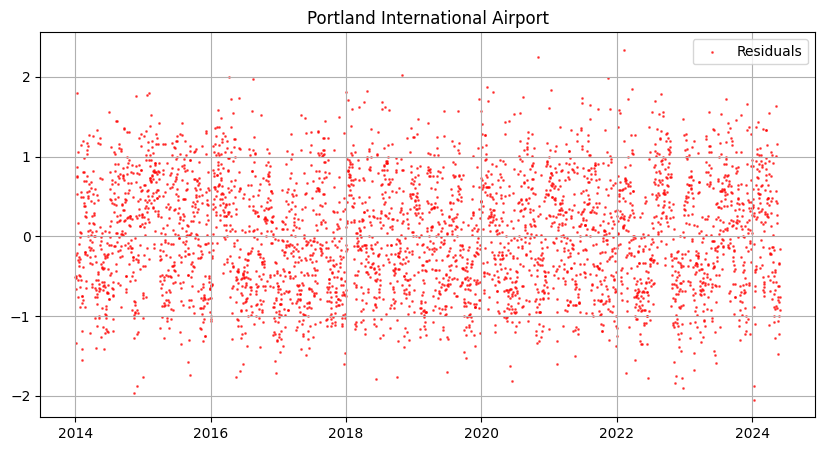

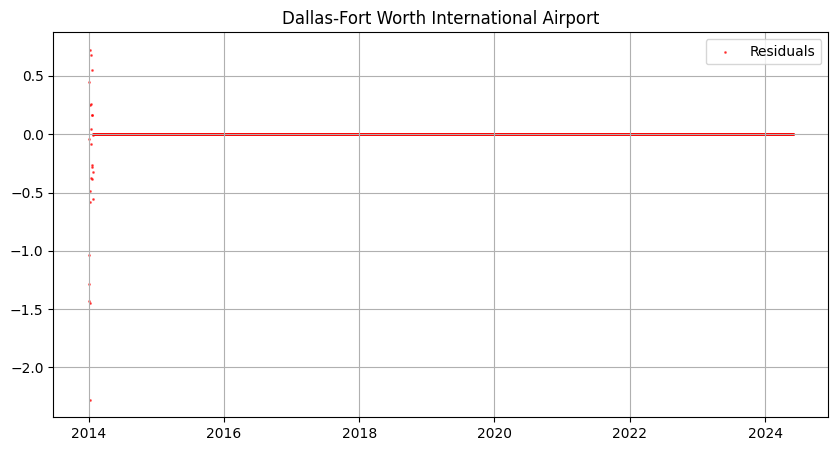

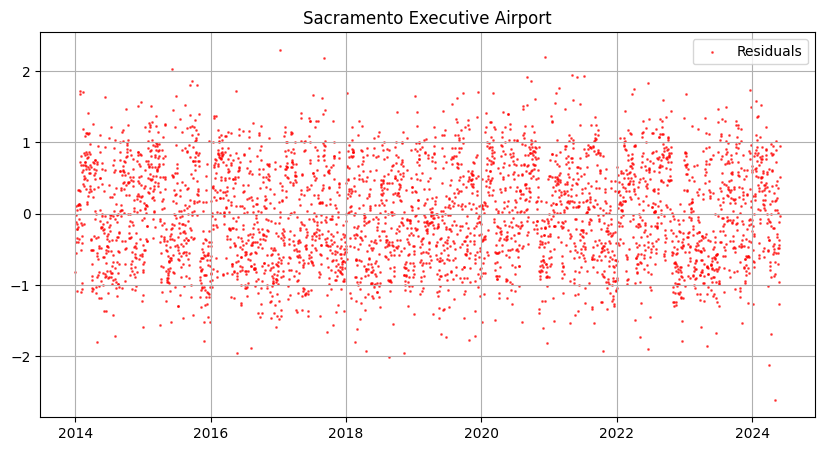

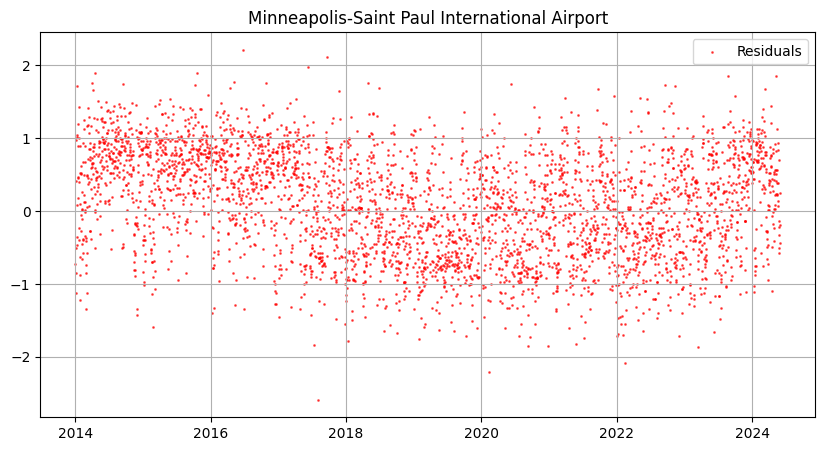

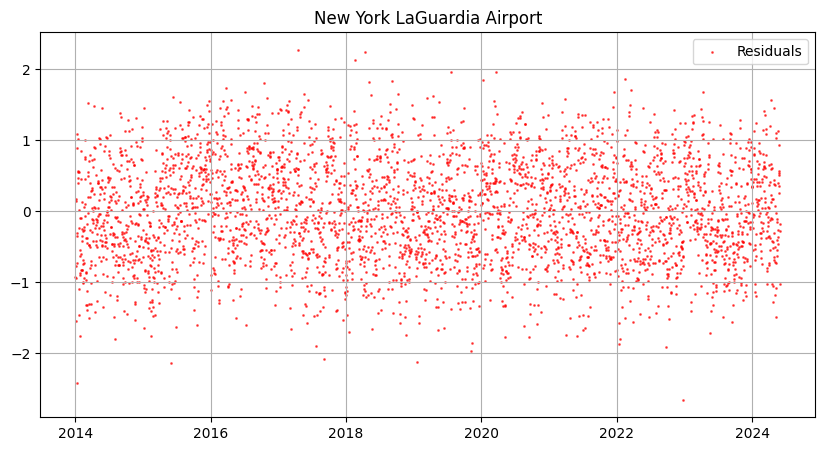

In [11]:
for station in SET_USA:
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))
    ax.set_title(f"{station}")
    ax.scatter(
        x=dct_fit_res[station]["vec_index"],
        y=dct_fit_res[station]["vec_res_scaled"],
        s=1,
        color="red",
        alpha=0.6,
        label="Residuals",
    )
    ax.grid(True)
    ax.legend()

## show phase_1 phase_2 coeffs are consistent (low std/mean) across 13 US stations


,intercept,slope,quadratic,amplitude_1,phase_1,amplitude_2,phase_2,amplitude_3,phase_3,amplitude_4,phase_4,omega,alpha,beta
count,13.000000,13.000000,1.300000e+01,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000,1.300000e+01,13.000000,1.300000e+01,1.300000e+01
mean,59.486166,0.000675,-8.473638e-08,-8.217449,0.183283,-11.785869,0.945788,0.292076,0.445514,1.185773,4.271069e-01,49.653345,8.480631e-01,6.499468e-03
std,8.588918,0.001630,3.080002e-07,2.345120,0.015377,3.422789,0.016147,32.535715,0.400895,29.932677,3.462695e-01,26.473990,3.092214e-01,2.163401e-02
min,46.407080,-0.001875,-4.586244e-07,-11.379219,0.151986,-18.402424,0.900590,-55.620680,0.000000,-61.898060,8.949727e-07,1.000462,1.002292e-10,1.000000e-10
25%,53.525920,-0.000437,-3.470336e-07,-10.940865,0.172594,-13.770866,0.942236,-29.617349,0.018220,-17.509059,9.497651e-02,25.981848,8.853887e-01,1.000000e-10
50%,57.190921,0.001448,-2.026597e-07,-7.088063,0.190394,-11.545861,0.950875,1.628302,0.509626,0.726149,5.491508e-01,55.748634,9.999447e-01,1.000001e-10
75%,67.590604,0.002174,1.740803e-07,-6.312630,0.196288,-10.420726,0.953624,25.229594,0.727104,16.447825,5.874883e-01,73.000681,1.000000e+00,5.533628e-05
max,72.382903,0.002269,4.143321e-07,-5.419800,0.199969,-4.148064,0.967821,54.201861,0.997275,52.097593,1.000000e+00,84.123910,1.000000e+00,7.829287e-02


array([[<Axes: title={'center': 'intercept'}>,
        <Axes: title={'center': 'slope'}>,
        <Axes: title={'center': 'quadratic'}>,
        <Axes: title={'center': 'amplitude_1'}>],
       [<Axes: title={'center': 'phase_1'}>,
        <Axes: title={'center': 'amplitude_2'}>,
        <Axes: title={'center': 'phase_2'}>,
        <Axes: title={'center': 'amplitude_3'}>],
       [<Axes: title={'center': 'phase_3'}>,
        <Axes: title={'center': 'amplitude_4'}>,
        <Axes: title={'center': 'phase_4'}>,
        <Axes: title={'center': 'omega'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'beta'}>, <Axes: >, <Axes: >]],
      dtype=object)

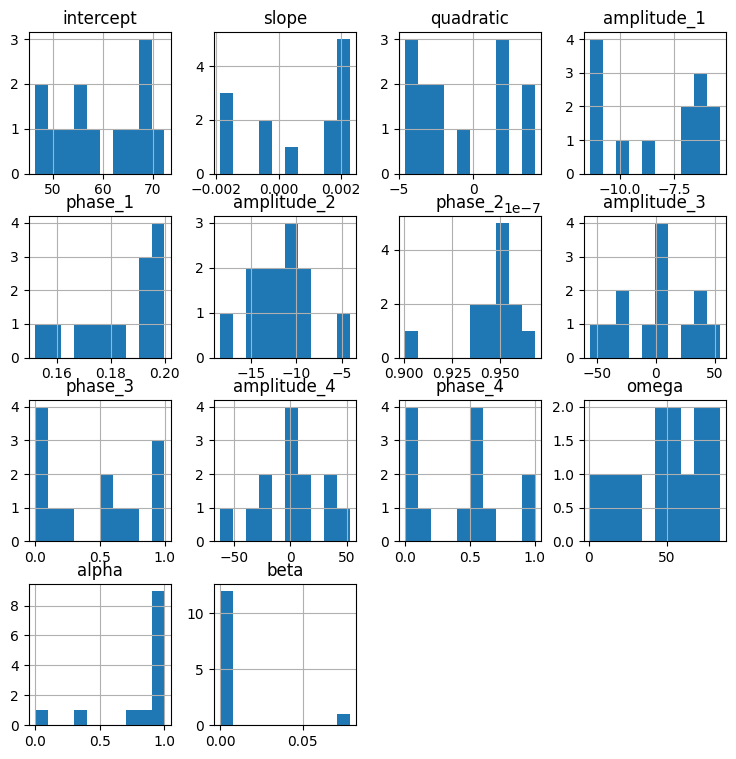

In [12]:
tmp_df = pd.DataFrame(
    {
        station: np.concat(
            [dct_fit_res[station]["fit_mean"].x, dct_fit_res[station]["fit_sgarch"].x]
        )
        for station in SET_USA
    },
    index=[
        "intercept",
        "slope",
        "quadratic",
        "amplitude_1",
        "phase_1",
        "amplitude_2",
        "phase_2",
        "amplitude_3",
        "phase_3",
        "amplitude_4",
        "phase_4",
        "omega",
        "alpha",
        "beta",
    ],
).T
display(tmp_df.describe())
tmp_df.hist(figsize=(9, 9))

## Residuals


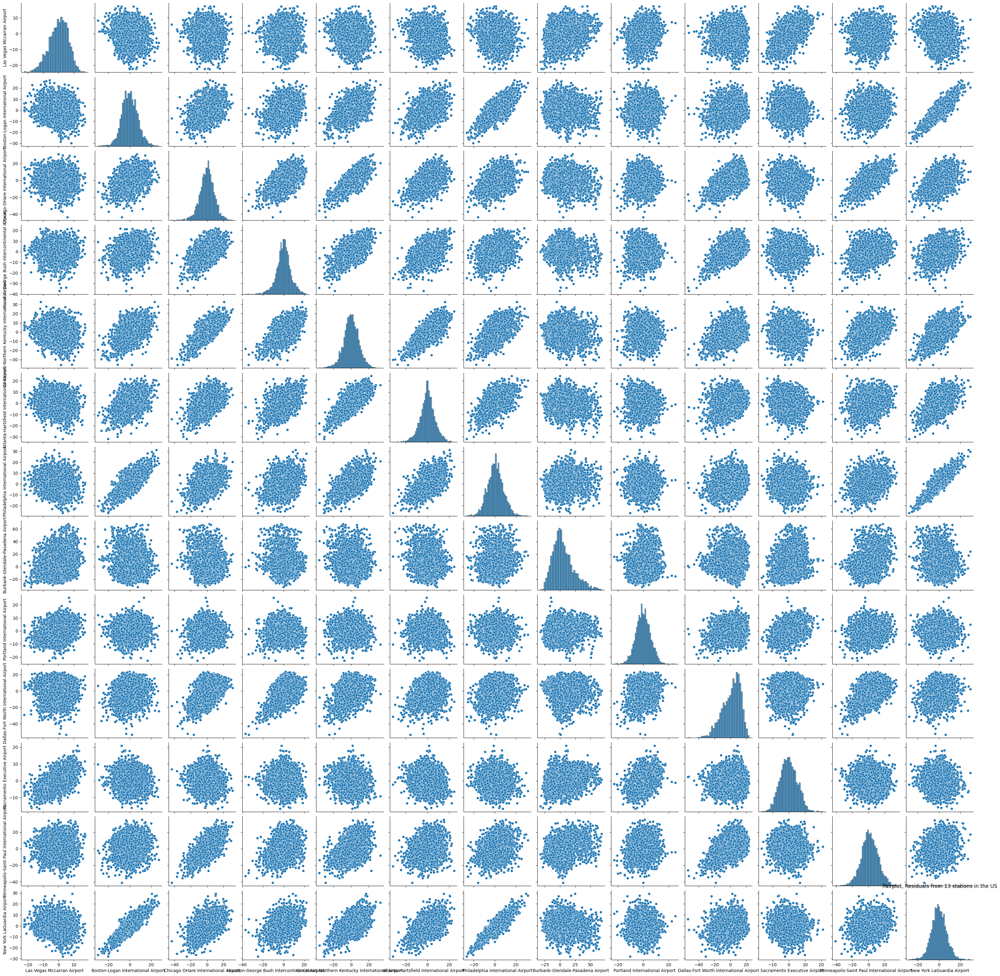

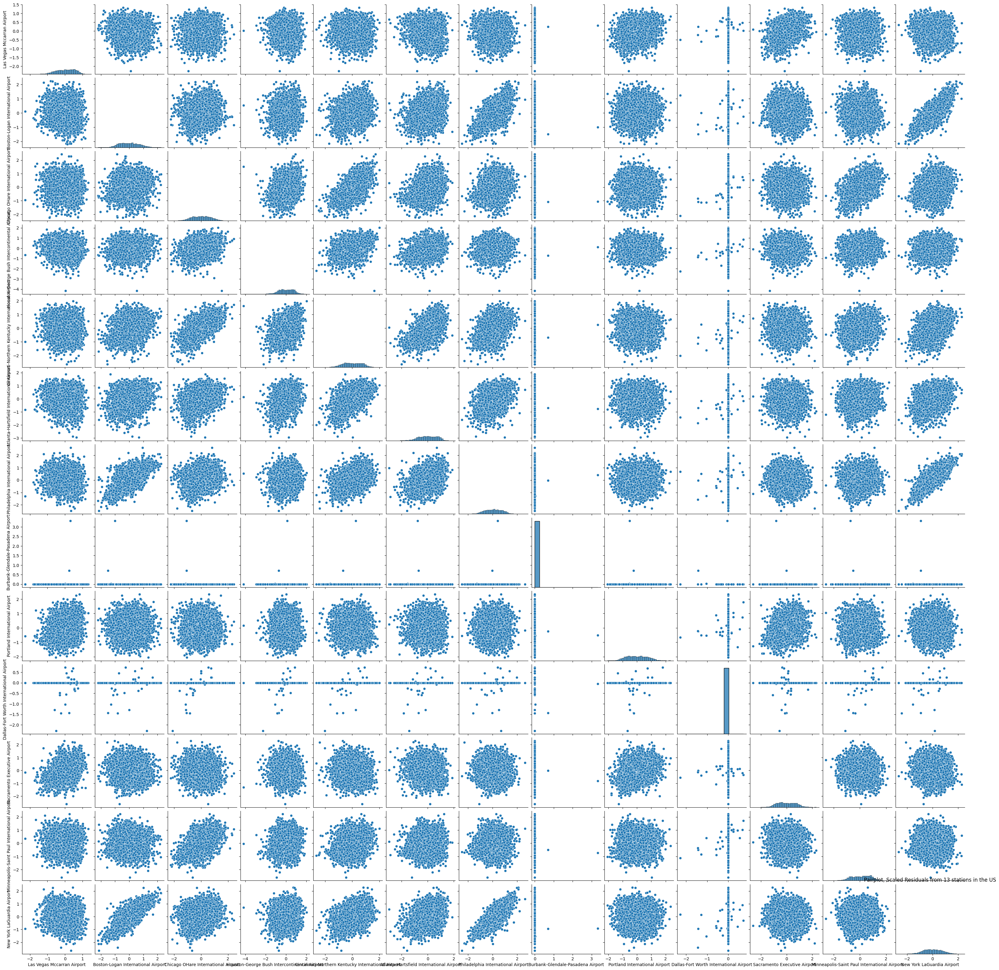

In [13]:
station = "New York LaGuardia Airport"
#
df_res = pd.DataFrame(
    {station: dct_fit_res[station]["vec_res"].values for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)
sns.pairplot(df_res)
plt.title("Pairplot, Residuals from 13 stations in the US")
#
df_res_scaled = pd.DataFrame(
    {station: dct_fit_res[station]["vec_res_scaled"].values for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)
sns.pairplot(df_res_scaled)
plt.title("Pairplot, Scaled Residuals from 13 stations in the US")
#
df_std = pd.DataFrame(
    {station: dct_fit_res[station]["vec_std"] for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)
df_y_pred = pd.DataFrame(
    {station: dct_fit_res[station]["vec_y_pred"] for station in SET_USA},
    index=dct_fit_res[station]["vec_index"],
)

Text(0.5, 1.0, "Kendall's tau, Residuals from 13 stations in the US")

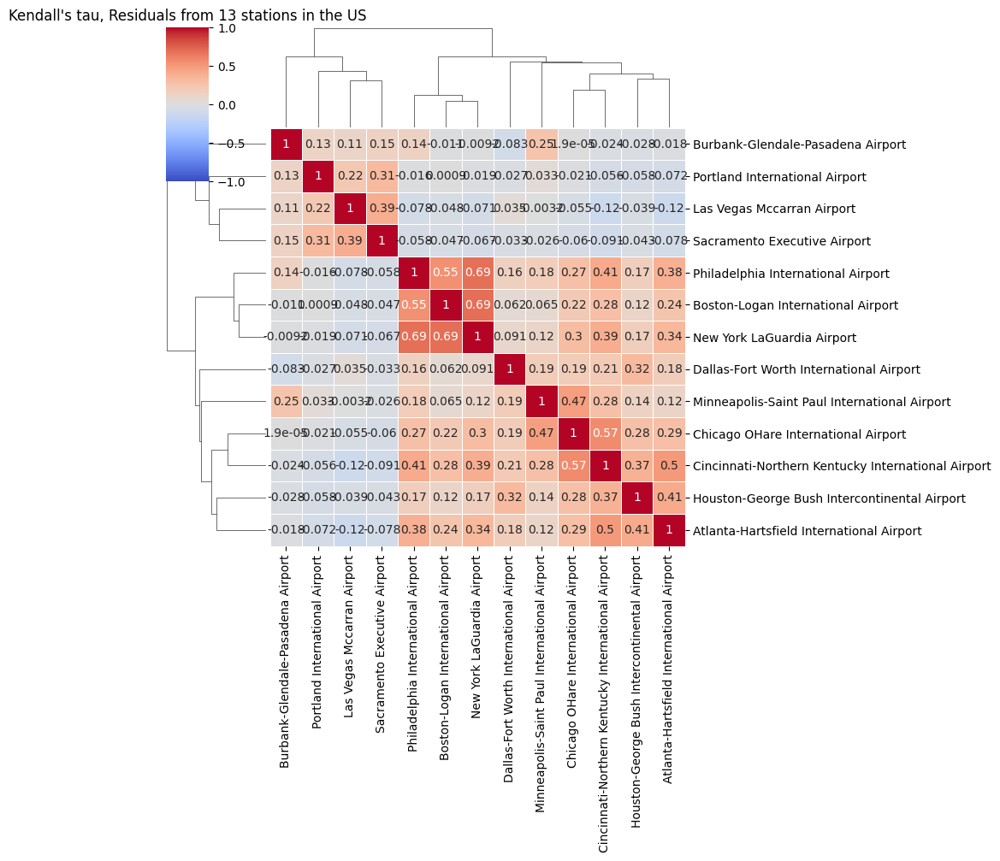

In [14]:
sns.clustermap(
    df_res.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)
plt.title("Kendall's tau, Residuals from 13 stations in the US")

#### Residuals EVI, Right


In [15]:
dct_evi_res_right = {}
for station in SET_USA:
    tmp_vec = df_res[station].values
    tmp_vec = tmp_vec[tmp_vec > 0]
    dct_evi_res_right[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [16]:
df_evi_res_right = pd.DataFrame(dct_evi_res_right).head(7)
df_evi_res_right[df_evi_res_right < 0] = np.abs(df_evi_res_right[df_evi_res_right < 0])
df_evi_res_right[np.isinf(df_evi_res_right)] = np.nan
display(df_evi_res_right)
df_evi_res_right.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,1.107038,3.001113,0.968494,0.733305,0.352105,0.643328,0.871275,0.540769,0.679457,0.584125,0.784482,0.426390,0.250204
schultze_steinebach,0.259410,0.296068,0.427924,0.309340,0.420539,0.289397,0.392351,0.446156,0.302537,0.423859,0.234823,0.447427,0.352698
smith,0.147717,0.169555,0.181893,0.164735,0.163676,0.154231,0.187519,0.165023,0.146604,0.094387,0.172145,0.131791,0.213880
meerschaert_scheffler,0.652367,0.705254,0.720784,0.694530,0.719119,0.694278,0.709187,0.845096,0.664913,0.711572,0.653794,0.746948,0.698927
genextreme,0.247160,0.124971,0.110741,0.054275,0.128197,0.075178,0.101161,0.052421,0.137151,0.432787,0.161826,0.188827,0.097669
genpareto,0.345298,0.245331,0.234776,0.214689,0.236151,0.221021,0.212537,0.222255,0.202549,0.555962,0.238474,0.314287,0.202039
pareto,0.188066,0.135372,0.152171,0.163346,0.140341,0.149763,0.100057,0.083620,0.095868,0.179719,0.164703,0.176934,0.180745


Las Vegas Mccarran Airport                            0.259410
Boston-Logan International Airport                    0.245331
Chicago OHare International Airport                   0.234776
Houston-George Bush Intercontinental Airport          0.214689
Cincinnati-Northern Kentucky International Airport    0.236151
Atlanta-Hartsfield International Airport              0.221021
Philadelphia International Airport                    0.212537
Burbank-Glendale-Pasadena Airport                     0.222255
Portland International Airport                        0.202549
Dallas-Fort Worth International Airport               0.432787
Sacramento Executive Airport                          0.234823
Minneapolis-Saint Paul International Airport          0.314287
New York LaGuardia Airport                            0.213880
dtype: float64

#### Residuals EVI, Left


In [17]:
dct_evi_res_left = {}
for station in SET_USA:
    tmp_vec = df_res[station].values
    tmp_vec = -tmp_vec[tmp_vec < 0]
    dct_evi_res_left[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [18]:
df_evi_res_left = pd.DataFrame(dct_evi_res_left).head(7)
df_evi_res_left[df_evi_res_left < 0] = np.abs(df_evi_res_left[df_evi_res_left < 0])
df_evi_res_left[np.isinf(df_evi_res_left)] = np.nan
display(df_evi_res_left)
df_evi_res_left.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,0.440222,0.034600,0.027660,0.834699,0.955968,1.286527,0.515288,1.110722,0.781649,0.434970,1.001123,0.942804,0.225572
schultze_steinebach,0.243184,0.337387,0.350879,0.308883,0.323415,0.240648,0.271424,0.287221,0.315417,0.414543,0.197410,0.318846,0.273179
smith,0.171364,0.210332,0.227111,0.230022,0.226059,0.182216,0.185826,0.096689,0.164771,0.205363,0.150799,0.194844,0.228880
meerschaert_scheffler,0.690442,0.696086,0.735537,0.712415,0.729619,0.704460,0.699737,0.755267,0.662866,0.784054,0.641811,0.747156,0.696372
genextreme,0.132003,0.108429,0.033153,0.039565,0.041016,0.005086,0.112187,0.293775,0.125593,0.124357,0.214528,0.062606,0.080418
genpareto,0.256445,0.204038,0.143207,0.081214,0.165433,0.130797,0.222888,0.398681,0.217290,0.212979,0.308405,0.183361,0.192548
pareto,0.141979,0.136424,0.150353,0.120110,0.146139,0.126032,0.200937,0.150038,0.155871,0.149952,0.173989,0.151226,0.153008


Las Vegas Mccarran Airport                            0.243184
Boston-Logan International Airport                    0.204038
Chicago OHare International Airport                   0.150353
Houston-George Bush Intercontinental Airport          0.230022
Cincinnati-Northern Kentucky International Airport    0.226059
Atlanta-Hartsfield International Airport              0.182216
Philadelphia International Airport                    0.222888
Burbank-Glendale-Pasadena Airport                     0.293775
Portland International Airport                        0.217290
Dallas-Fort Worth International Airport               0.212979
Sacramento Executive Airport                          0.214528
Minneapolis-Saint Paul International Airport          0.194844
New York LaGuardia Airport                            0.225572
dtype: float64

# CDD

max(0, (avgtemp - 65F)), in CDD months


In [19]:
df_cdd = (df_avg_all[df_avg_all.index.month.isin(MONTH_CDD)] - 65).clip(lower=0)
df_cdd.describe()

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
count,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000,1561.000000
mean,22.551890,5.949071,6.658232,17.721332,7.813581,12.858104,9.497438,9.096092,4.346252,17.367393,8.722293,5.990391,9.264574
std,8.622879,5.890437,5.761355,5.058838,5.288307,5.127466,6.489834,6.554729,5.002314,6.660328,5.821482,5.524297,6.696140
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,0.000000,0.000000,14.500000,3.500000,10.000000,3.500000,3.500000,0.000000,13.000000,4.000000,0.000000,3.000000
50%,24.000000,5.000000,6.000000,18.500000,8.500000,13.500000,10.000000,9.000000,2.500000,18.500000,9.000000,5.000000,10.000000
75%,29.000000,10.000000,11.500000,21.500000,12.000000,16.500000,14.500000,14.000000,7.500000,22.000000,12.500000,10.000000,14.500000
max,40.500000,25.500000,22.500000,30.000000,20.500000,24.000000,25.000000,32.000000,30.500000,32.500000,28.500000,25.000000,26.500000


Text(0.5, 1.0, 'Pairplot, CDD from 13 stations in the US')

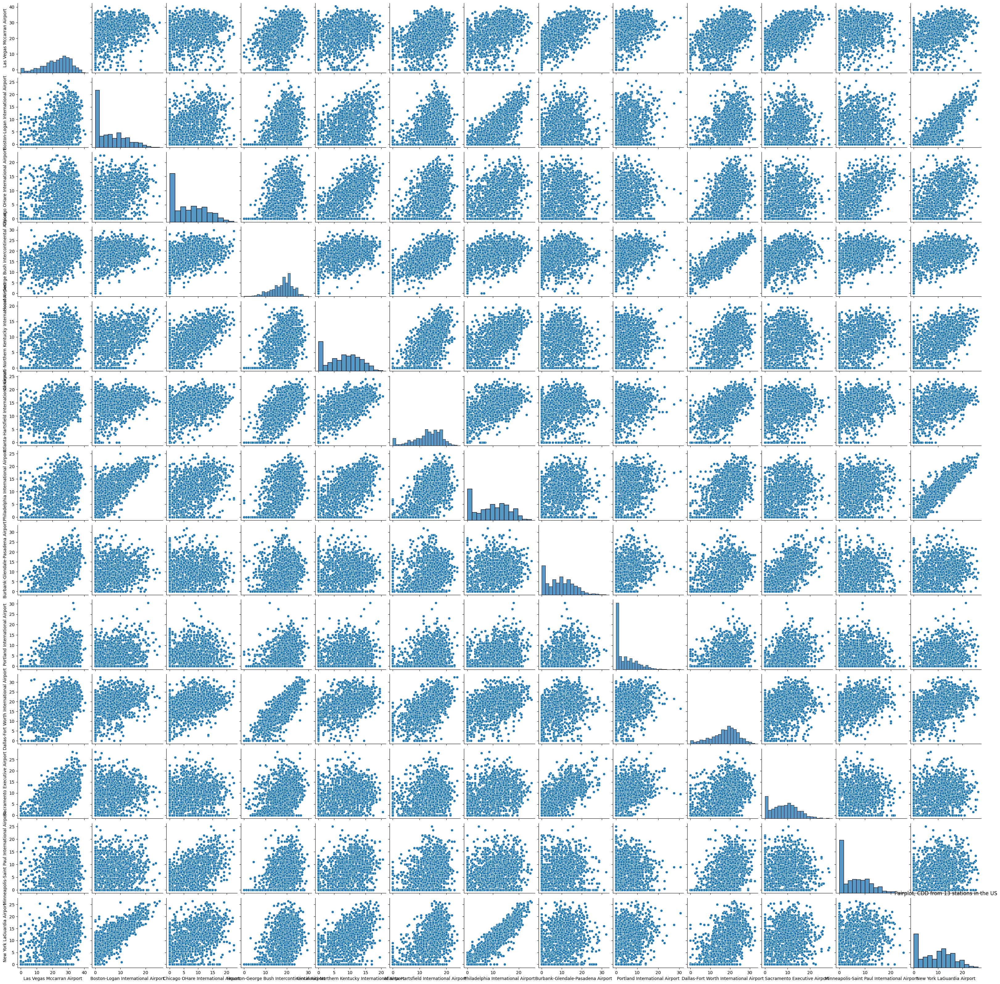

In [20]:
sns.pairplot(df_cdd)
plt.title("Pairplot, CDD from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, CDD from 13 stations in the US")

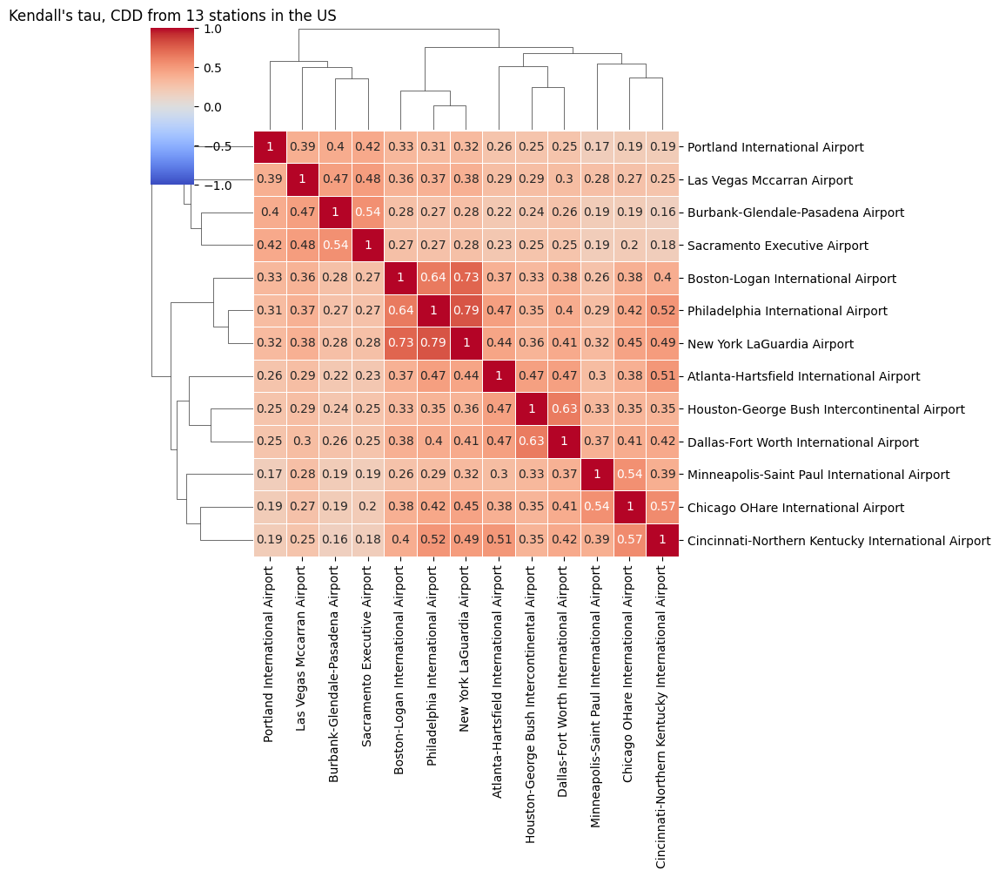

In [21]:
sns.clustermap(
    df_cdd.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)
plt.title("Kendall's tau, CDD from 13 stations in the US")

## CDD EVI


In [22]:
dct_evi_cdd = {}
for station in SET_USA:
    tmp_vec = df_cdd[station].values
    dct_evi_cdd[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

/home/codespace/.local/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:7946: RuntimeWarning: divide by zero encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))
/home/codespace/.local/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:7946: RuntimeWarning: invalid value encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))


In [23]:
df_evi_cdd = pd.DataFrame(dct_evi_cdd).head(7)
df_evi_cdd[df_evi_cdd < 0] = np.abs(df_evi_cdd[df_evi_cdd < 0])
df_evi_cdd[np.isinf(df_evi_cdd)] = np.nan
display(df_evi_cdd)
df_evi_cdd.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,NaN,NaN,NaN,0.422897,NaN,NaN,NaN,NaN,NaN,0.407071,NaN,NaN,NaN
schultze_steinebach,NaN,NaN,NaN,0.684795,NaN,NaN,NaN,NaN,NaN,0.656750,NaN,NaN,NaN
smith,0.053210,0.128477,0.121005,0.067468,0.082082,0.068149,0.084605,0.160984,0.178896,0.069384,0.135095,0.143034,0.110064
meerschaert_scheffler,0.792952,0.741125,0.738111,0.720427,0.726460,0.722259,0.754304,0.755657,0.718899,0.757830,0.739523,0.732397,0.758560
genextreme,0.727397,5.500061,0.244222,0.749206,0.474740,0.681502,0.474367,0.290009,2.318805,0.676157,0.323441,0.063438,0.412145
genpareto,0.945941,3.355212,0.400698,0.991101,0.589337,0.885847,0.588789,0.379471,2.424306,0.884237,0.415687,3.141981,0.527246
pareto,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Las Vegas Mccarran Airport                            0.760174
Boston-Logan International Airport                    2.048169
Chicago OHare International Airport                   0.322460
Houston-George Bush Intercontinental Airport          0.702611
Cincinnati-Northern Kentucky International Airport    0.532039
Atlanta-Hartsfield International Airport              0.701881
Philadelphia International Airport                    0.531578
Burbank-Glendale-Pasadena Airport                     0.334740
Portland International Airport                        1.518852
Dallas-Fort Worth International Airport               0.666453
Sacramento Executive Airport                          0.369564
Minneapolis-Saint Paul International Airport          0.437715
New York LaGuardia Airport                            0.469695
dtype: float64

# CDD Residual: CDD - CDD_pred

> CDD - CDD_prediction, notice both are processed as max(0, avgtemp-65)


Text(0.5, 1.0, 'Pairplot, CDD residuals from 13 stations in the US')

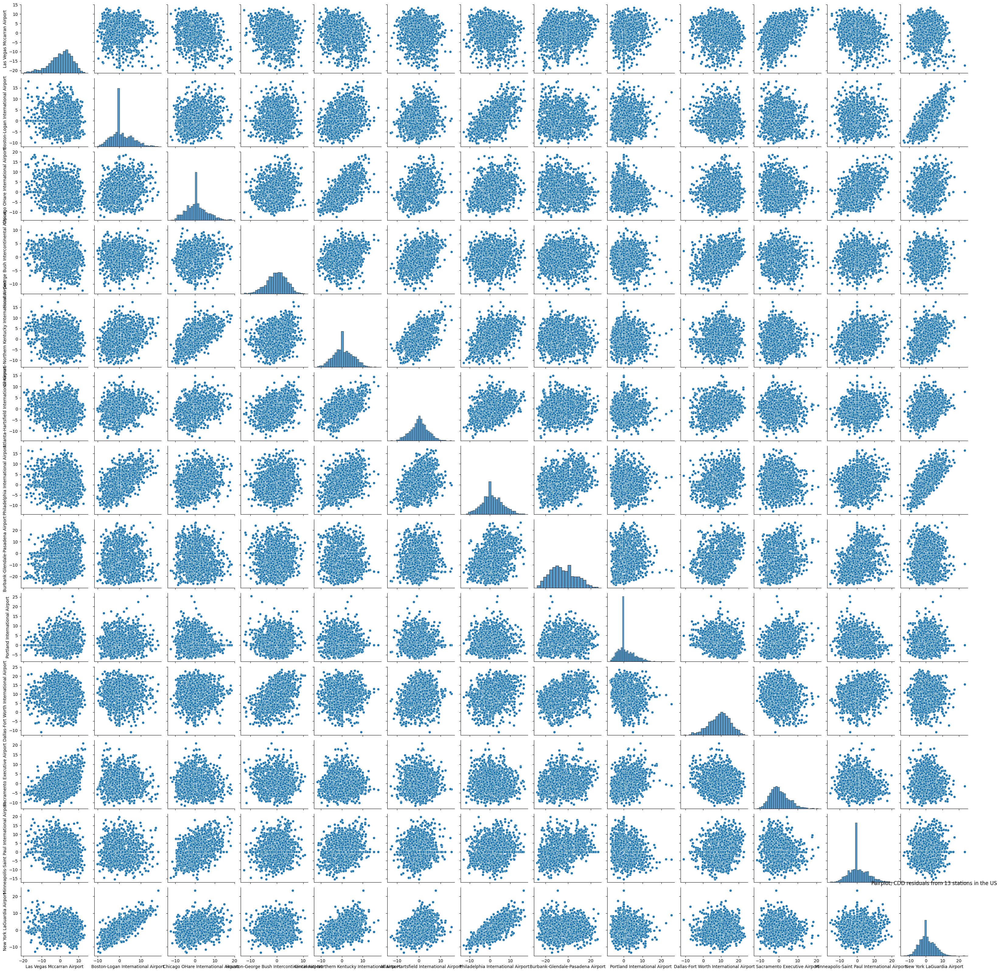

In [24]:
df_cdd_pred = (
    pd.DataFrame(
        {station: dct_fit_res[station]["vec_y_pred"].values for station in SET_USA},
        index=dct_fit_res[station]["vec_index"],
    )
    - 65
).clip(lower=0)
df_cdd_pred = df_cdd_pred[df_cdd_pred.index.month.isin(MONTH_CDD)]
df_cdd_res = df_cdd - df_cdd_pred
sns.pairplot(df_cdd_res)
plt.title("Pairplot, CDD residuals from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, CDD residuals from 13 stations in the US")

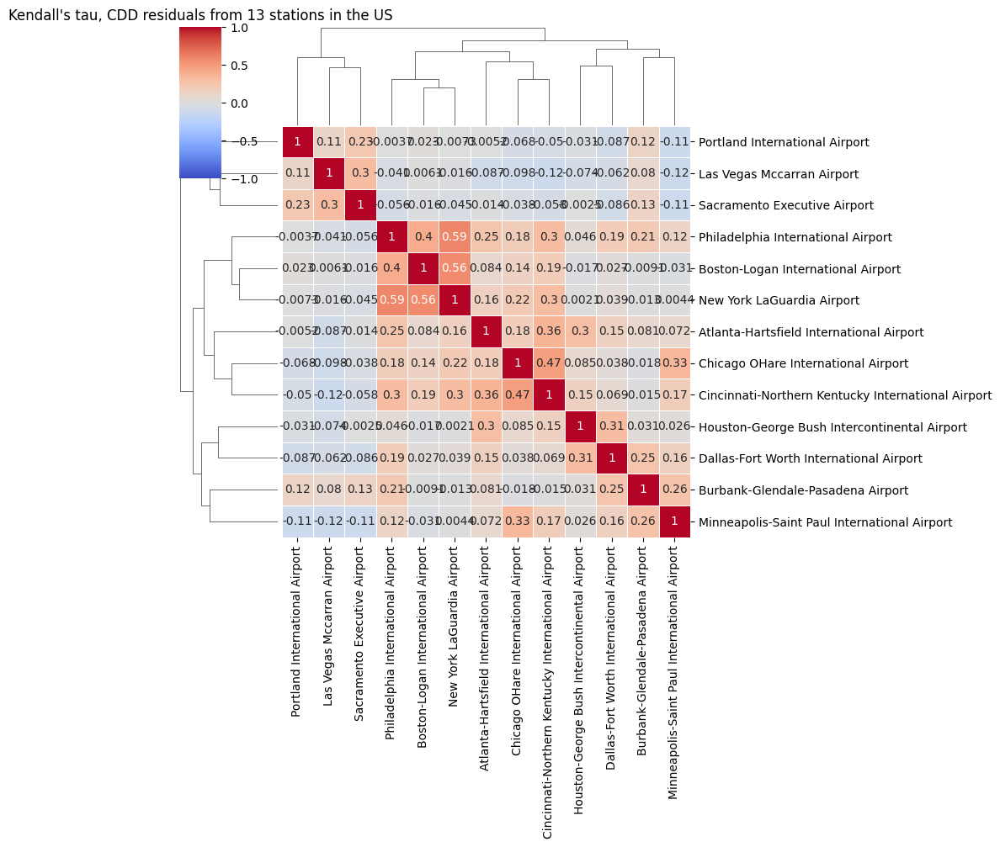

In [25]:
g = sns.clustermap(
    df_cdd_res.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)

plt.title("Kendall's tau, CDD residuals from 13 stations in the US")

## CDD Residual EVI, Right


In [26]:
dct_evi_cdd_res_right = {}
for station in SET_USA:
    tmp_vec = df_cdd_res[station].values
    # ! right tail
    tmp_vec = tmp_vec[tmp_vec > 0]
    dct_evi_cdd_res_right[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [27]:
df_evi_cdd_res_right = pd.DataFrame(dct_evi_cdd_res_right).head(7)
df_evi_cdd_res_right[df_evi_cdd_res_right < 0] = np.abs(
    df_evi_cdd_res_right[df_evi_cdd_res_right < 0]
)
df_evi_cdd_res_right[np.isinf(df_evi_cdd_res_right)] = np.nan
display(df_evi_cdd_res_right)
df_evi_cdd_res_right.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,2.095370,0.071643,0.039337,0.422440,0.271214,1.279882,0.187632,1.146817,0.200424,0.802761,0.061023,1.173715,0.494124
schultze_steinebach,0.259977,0.219350,0.325137,0.307076,0.261639,0.181272,0.308742,0.238544,0.352042,0.529248,0.112769,0.346944,0.253350
smith,0.116392,0.207741,0.166909,0.160328,0.159667,0.168890,0.121643,0.146531,0.184745,0.081599,0.204106,0.147712,0.191891
meerschaert_scheffler,0.656148,0.694659,0.701904,0.602841,0.669398,0.640257,0.686841,0.784575,0.699522,0.720096,0.692511,0.711705,0.680637
genextreme,0.353949,0.211503,0.165446,0.229494,0.210551,0.095386,0.218985,0.320482,0.116570,0.510584,0.093976,0.218591,0.132155
genpareto,0.473718,0.336277,0.303985,0.333686,0.299014,0.214794,0.356449,0.452938,0.196784,0.660408,0.214070,0.350941,0.202149
pareto,0.207944,0.199570,0.163745,0.178508,0.149297,0.162151,0.152490,0.087228,0.202952,0.172951,0.165309,0.250509,0.188542


Las Vegas Mccarran Airport                            0.353949
Boston-Logan International Airport                    0.211503
Chicago OHare International Airport                   0.166909
Houston-George Bush Intercontinental Airport          0.307076
Cincinnati-Northern Kentucky International Airport    0.261639
Atlanta-Hartsfield International Airport              0.181272
Philadelphia International Airport                    0.218985
Burbank-Glendale-Pasadena Airport                     0.320482
Portland International Airport                        0.200424
Dallas-Fort Worth International Airport               0.529248
Sacramento Executive Airport                          0.165309
Minneapolis-Saint Paul International Airport          0.346944
New York LaGuardia Airport                            0.202149
dtype: float64

## CDD Residual EVI, Left


In [28]:
dct_evi_cdd_res_left = {}
for station in SET_USA:
    tmp_vec = df_cdd_res[station].values
    # ! left tail
    tmp_vec = -tmp_vec[tmp_vec < 0]
    dct_evi_cdd_res_left[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [29]:
df_evi_cdd_res_left = pd.DataFrame(dct_evi_cdd_res_left).head(7)
df_evi_cdd_res_left[df_evi_cdd_res_left < 0] = np.abs(
    df_evi_cdd_res_left[df_evi_cdd_res_left < 0]
)
df_evi_cdd_res_left[np.isinf(df_evi_cdd_res_left)] = np.nan
display(df_evi_cdd_res_left)
df_evi_cdd_res_left.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,1.824698,1.473536,0.653084,0.716953,0.425388,0.645323,1.044989,1.283458,0.061089,0.994508,0.670905,0.951176,0.988395
schultze_steinebach,0.214661,0.106246,0.315536,0.155695,0.186196,0.039729,0.150910,0.249393,0.025918,0.026281,0.114090,0.152905,0.224558
smith,0.141833,0.106044,0.093626,0.159911,0.150839,0.120772,0.088419,0.062769,0.092539,0.171533,0.133244,0.148655,0.172795
meerschaert_scheffler,0.728197,0.633978,0.651437,0.634382,0.646100,0.639058,0.654465,0.770178,0.583272,0.677919,0.627524,0.673773,0.638135
genextreme,0.078794,0.313608,0.308629,0.130576,0.240686,0.133549,0.222030,0.505201,0.373754,0.174013,0.278547,0.241416,0.211633
genpareto,0.270385,0.455516,0.420076,0.269965,0.394837,0.273086,0.366840,0.649835,0.536037,0.293990,0.400936,0.356641,0.316771
pareto,0.180147,0.147137,0.163319,0.209762,0.159064,0.134510,0.261905,0.161684,0.245494,0.233114,0.183203,0.182754,0.207189


Las Vegas Mccarran Airport                            0.214661
Boston-Logan International Airport                    0.313608
Chicago OHare International Airport                   0.315536
Houston-George Bush Intercontinental Airport          0.209762
Cincinnati-Northern Kentucky International Airport    0.240686
Atlanta-Hartsfield International Airport              0.134510
Philadelphia International Airport                    0.261905
Burbank-Glendale-Pasadena Airport                     0.505201
Portland International Airport                        0.245494
Dallas-Fort Worth International Airport               0.233114
Sacramento Executive Airport                          0.278547
Minneapolis-Saint Paul International Airport          0.241416
New York LaGuardia Airport                            0.224558
dtype: float64

# HDD

max(0, (65F - avgtemp)), in HDD months


In [30]:
df_hdd = (65 - df_avg_all[df_avg_all.index.month.isin(MONTH_HDD)]).clip(lower=0)
df_hdd.describe()

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
count,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000,1603.000000
mean,10.625390,27.876482,31.925764,7.564566,25.939177,13.523706,23.787898,6.759513,20.267623,12.372739,13.176544,39.055209,23.881160
std,6.910761,10.198943,12.683403,8.049785,11.995456,9.415323,10.040411,5.224698,6.416548,10.102256,5.595195,14.173294,10.060107
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,5.000000,21.500000,24.000000,0.000000,18.000000,5.500000,17.000000,2.000000,16.000000,3.500000,9.000000,30.000000,17.000000
50%,11.000000,27.500000,30.500000,5.500000,25.000000,13.500000,23.500000,6.500000,20.000000,11.500000,13.500000,37.000000,23.500000
75%,15.500000,34.500000,39.000000,13.000000,33.500000,20.500000,30.000000,10.500000,24.000000,19.000000,17.000000,47.500000,30.000000
max,28.000000,63.500000,81.500000,44.500000,65.000000,49.000000,56.500000,22.500000,47.000000,57.000000,28.500000,85.500000,56.000000


Text(0.5, 1.0, 'Pairplot, HDD from 13 stations in the US')

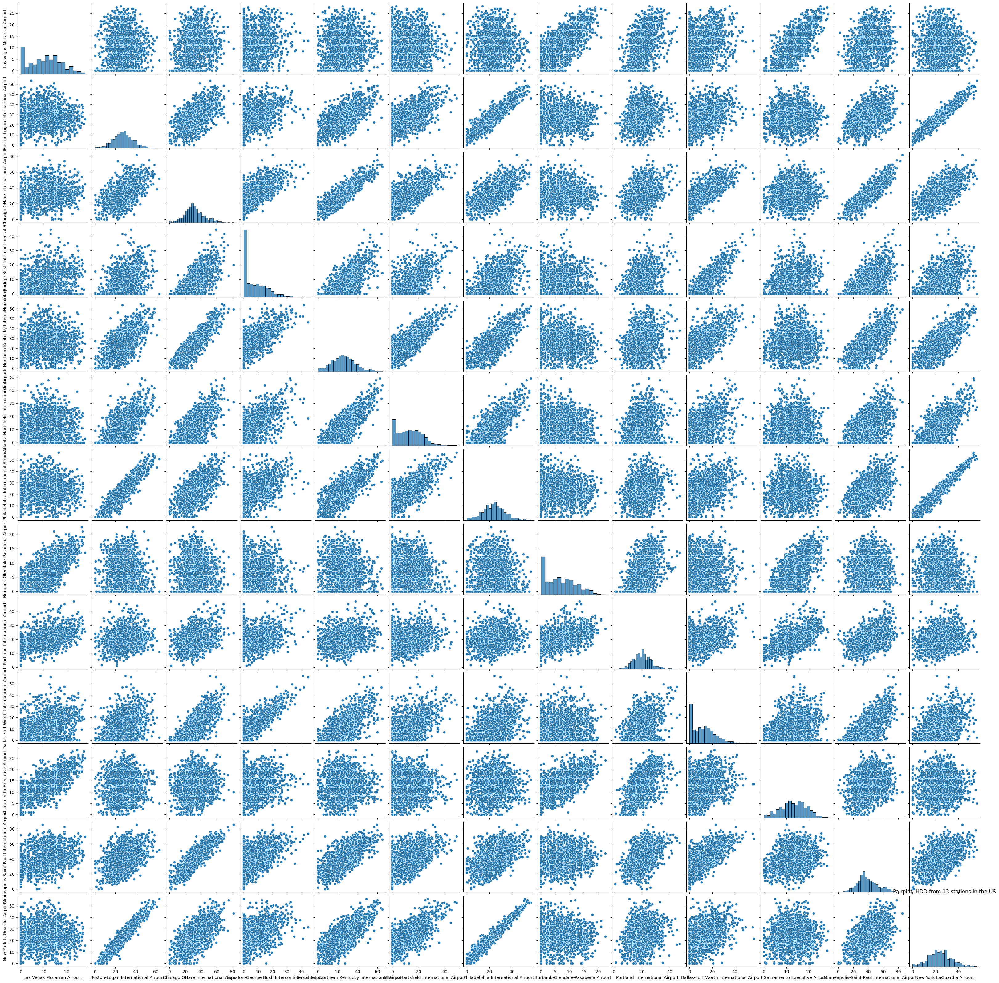

In [31]:
sns.pairplot(df_hdd)
plt.title("Pairplot, HDD from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, HDD from 13 stations in the US")

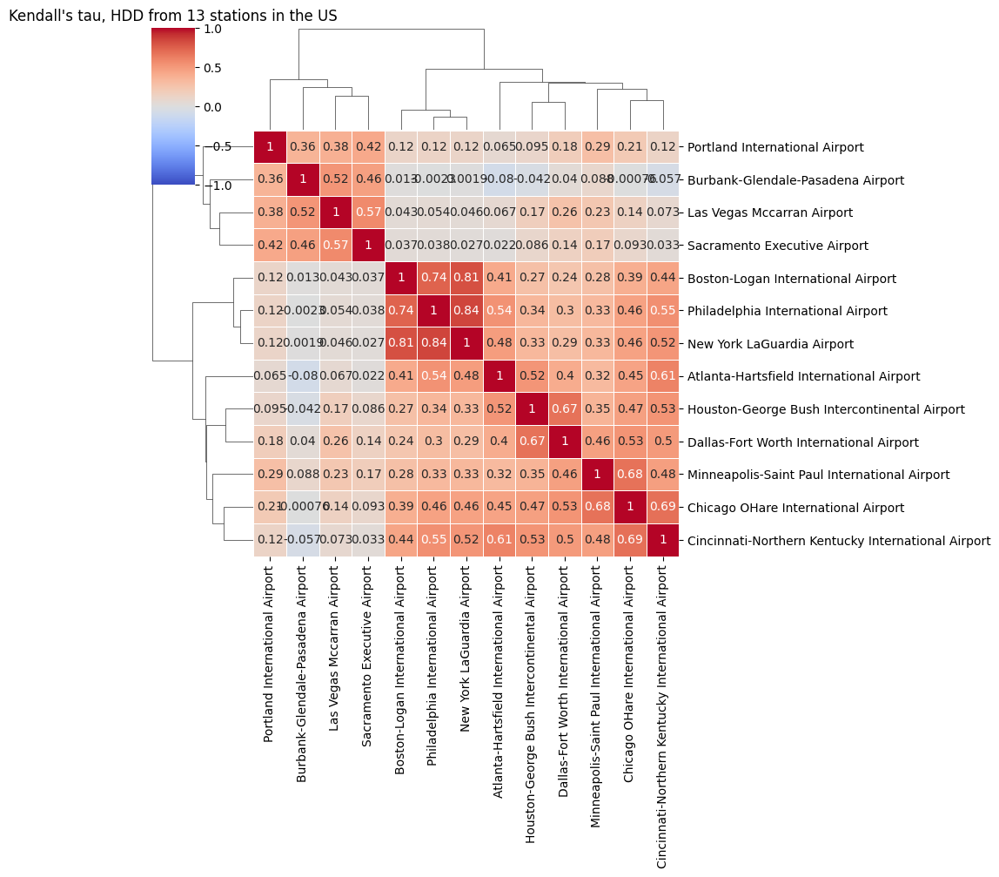

In [32]:
g = sns.clustermap(
    df_hdd.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)

plt.title("Kendall's tau, HDD from 13 stations in the US")

## HDD EVI


In [33]:
dct_evi_hdd = {}
for station in SET_USA:
    tmp_vec = df_hdd[station].values
    dct_evi_hdd[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

/home/codespace/.local/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:7946: RuntimeWarning: divide by zero encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))
/home/codespace/.local/lib/python3.12/site-packages/scipy/stats/_continuous_distns.py:7946: RuntimeWarning: invalid value encountered in divide
  return ndata / np.sum(np.log((data - location) / scale))


In [34]:
df_evi_hdd = pd.DataFrame(dct_evi_hdd).head(7)
df_evi_hdd[df_evi_hdd < 0] = np.abs(df_evi_hdd[df_evi_hdd < 0])
df_evi_hdd[np.isinf(df_evi_hdd)] = np.nan
display(df_evi_hdd)
df_evi_hdd.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,NaN,0.158216,0.346634,NaN,0.313166,NaN,0.072536,0.568926,0.240302,NaN,0.647685,0.427384,0.036760
schultze_steinebach,NaN,0.782403,0.756207,NaN,0.699529,NaN,0.718148,0.477063,0.675272,NaN,0.563021,0.818442,0.728972
smith,0.087908,0.107083,0.103249,0.201109,0.131269,0.170514,0.125919,0.102371,0.123606,0.172451,0.092869,0.071155,0.116969
meerschaert_scheffler,0.761906,0.814646,0.844188,0.782580,0.836631,0.803813,0.812523,0.724006,0.751851,0.813355,0.733290,0.859238,0.812789
genextreme,0.459618,0.478428,0.408528,3.085821,0.438480,0.274940,0.465143,0.321934,0.453032,0.151575,0.541276,0.509713,0.475150
genpareto,0.584168,0.631332,0.538911,5.136412,0.574142,0.360671,0.610097,0.422721,0.602483,0.249281,0.704812,0.672535,0.623390
pareto,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.338767,NaN,NaN,NaN,NaN


Las Vegas Mccarran Airport                            0.521893
Boston-Logan International Airport                    0.554880
Chicago OHare International Airport                   0.473719
Houston-George Bush Intercontinental Airport          1.934200
Cincinnati-Northern Kentucky International Airport    0.506311
Atlanta-Hartsfield International Airport              0.317806
Philadelphia International Airport                    0.537620
Burbank-Glendale-Pasadena Airport                     0.449892
Portland International Airport                        0.453032
Dallas-Fort Worth International Airport               0.210866
Sacramento Executive Airport                          0.605353
Minneapolis-Saint Paul International Airport          0.591124
New York LaGuardia Airport                            0.549270
dtype: float64

# HDD Residual: HDD - HDD_pred

> HDD - HDD_prediction, notice both are processed as max(0, 65-avgtemp)


Text(0.5, 1.0, 'Pairplot, HDD residuals from 13 stations in the US')

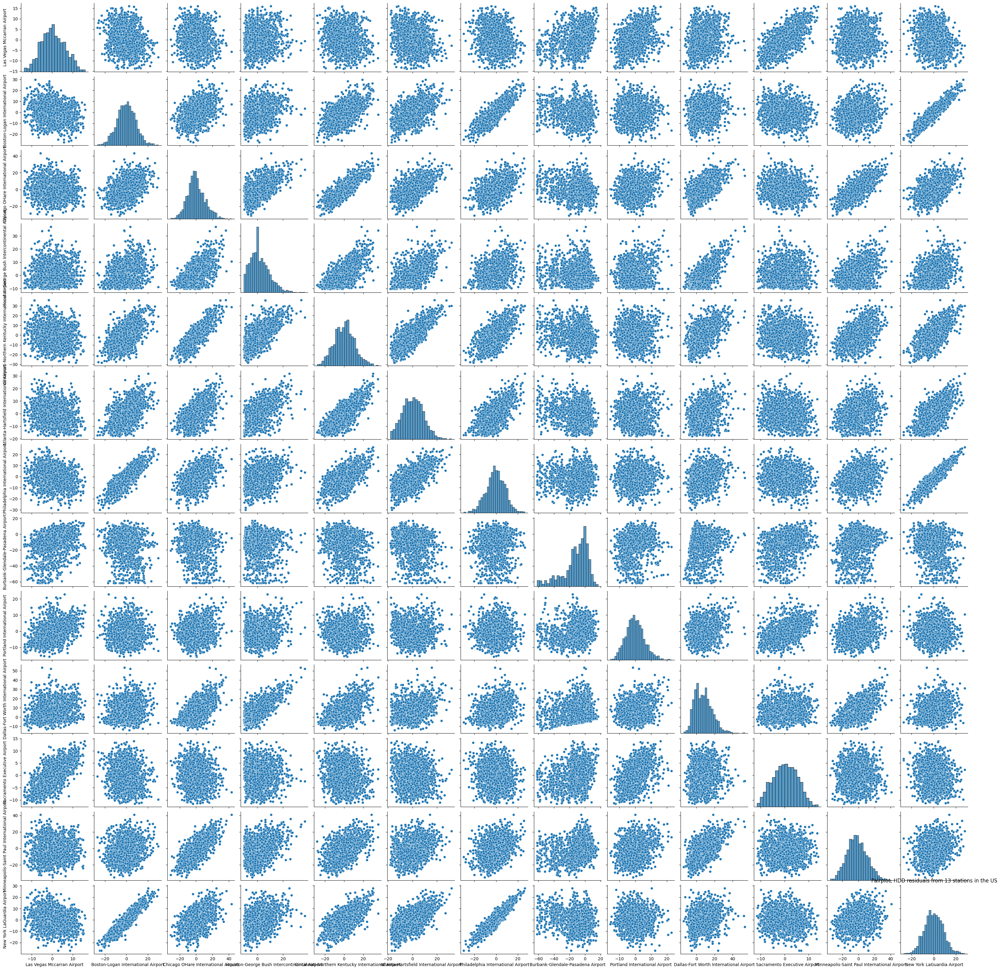

In [35]:
df_hdd_pred = (
    65
    - pd.DataFrame(
        {station: dct_fit_res[station]["vec_y_pred"].values for station in SET_USA},
        index=dct_fit_res[station]["vec_index"],
    )
).clip(lower=0)
df_hdd_pred = df_hdd_pred[df_hdd_pred.index.month.isin(MONTH_HDD)]
df_hdd_res = df_hdd - df_hdd_pred
sns.pairplot(df_hdd_res)
plt.title("Pairplot, HDD residuals from 13 stations in the US")

Text(0.5, 1.0, "Kendall's tau, HDD residuals from 13 stations in the US")

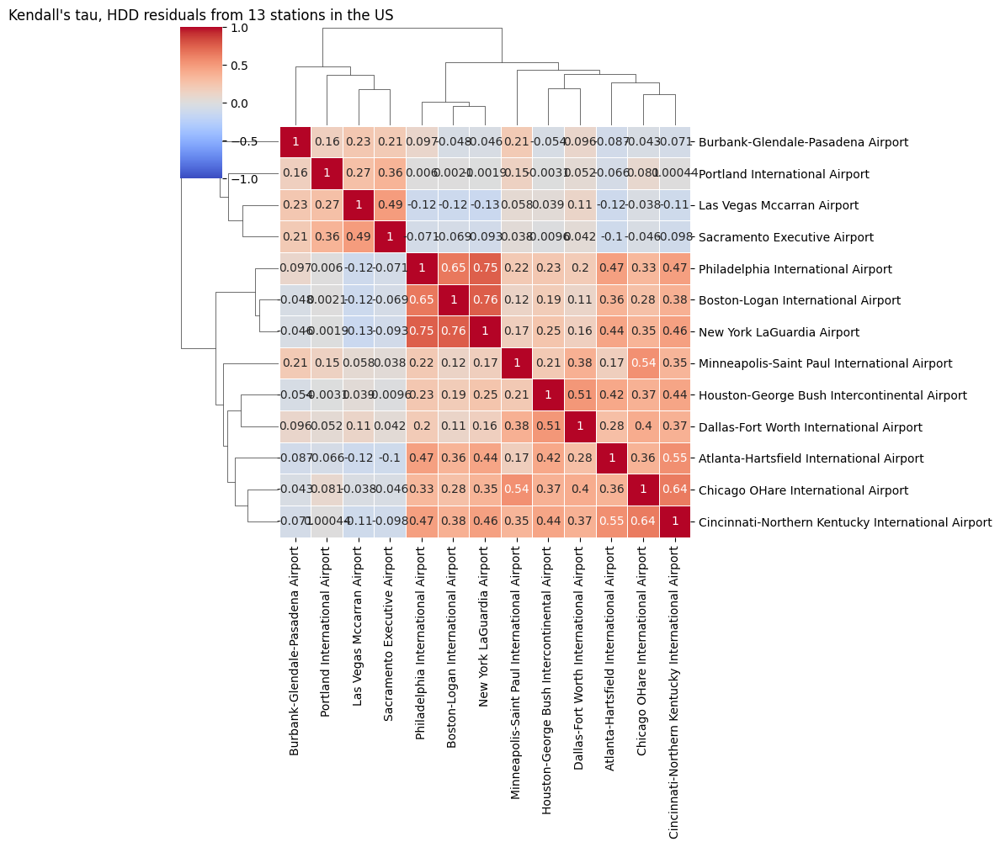

In [36]:
g = sns.clustermap(
    df_hdd_res.corr(method="kendall"),
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=-1,
    vmax=1,
)

plt.title("Kendall's tau, HDD residuals from 13 stations in the US")

## HDD Residual EVI, Right


In [37]:
dct_evi_hdd_res_right = {}
for station in SET_USA:
    tmp_vec = df_hdd_res[station].values
    # ! right tail
    tmp_vec = tmp_vec[tmp_vec > 0]
    dct_evi_hdd_res_right[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [38]:
df_evi_hdd_res_right = pd.DataFrame(dct_evi_hdd_res_right).head(7)
df_evi_hdd_res_right[df_evi_hdd_res_right < 0] = np.abs(
    df_evi_hdd_res_right[df_evi_hdd_res_right < 0]
)
df_evi_hdd_res_right[np.isinf(df_evi_hdd_res_right)] = np.nan
display(df_evi_hdd_res_right)
df_evi_hdd_res_right.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,0.722577,0.704175,1.149659,1.865240,0.865184,1.133128,0.315986,0.406212,0.984746,0.952106,0.583791,1.008285,1.013627
schultze_steinebach,0.234054,0.296437,0.388045,0.411386,0.382804,0.245143,0.258125,0.097752,0.285609,0.437497,0.104991,0.453393,0.236406
smith,0.107978,0.224346,0.163526,0.212914,0.132152,0.192133,0.210490,0.189407,0.188339,0.214096,0.143706,0.152075,0.199309
meerschaert_scheffler,0.691107,0.750113,0.804862,0.766003,0.786232,0.749602,0.743130,0.712385,0.708211,0.797955,0.657439,0.809891,0.748293
genextreme,0.304781,0.126820,0.098476,0.106126,0.112189,0.139055,0.153332,0.162732,0.070650,0.176816,0.281854,0.164471,0.134392
genpareto,0.444395,0.249564,0.222716,0.212081,0.256016,0.245841,0.277165,0.305822,0.200325,0.255742,0.409205,0.283223,0.266203
pareto,0.183330,0.179841,0.169089,0.114108,0.205011,0.127729,0.215553,0.250409,0.160186,0.145312,0.177935,0.144946,0.148240


Las Vegas Mccarran Airport                            0.304781
Boston-Logan International Airport                    0.249564
Chicago OHare International Airport                   0.222716
Houston-George Bush Intercontinental Airport          0.212914
Cincinnati-Northern Kentucky International Airport    0.256016
Atlanta-Hartsfield International Airport              0.245143
Philadelphia International Airport                    0.258125
Burbank-Glendale-Pasadena Airport                     0.250409
Portland International Airport                        0.200325
Dallas-Fort Worth International Airport               0.255742
Sacramento Executive Airport                          0.281854
Minneapolis-Saint Paul International Airport          0.283223
New York LaGuardia Airport                            0.236406
dtype: float64

## HDD Residual EVI, Left


In [39]:
dct_evi_hdd_res_left = {}
for station in SET_USA:
    tmp_vec = df_hdd_res[station].values
    # ! left tail
    tmp_vec = -tmp_vec[tmp_vec < 0]
    dct_evi_hdd_res_left[station] = {
        "hill": unibm.benchmark.est_extreme_value_index_hill(torch.tensor(tmp_vec)),
        "schultze_steinebach": unibm.benchmark.est_extreme_value_index_schultze_steinebach(
            torch.tensor(tmp_vec)
        ),
        "smith": unibm.benchmark.est_extreme_value_index_smith(torch.tensor(tmp_vec)),
        "meerschaert_scheffler": unibm.benchmark.est_extreme_value_index_meerschaert_scheffler(
            torch.tensor(tmp_vec)
        ),
        "genextreme": genextreme.fit(tmp_vec, floc=0)[0].item(),
        "genpareto": genpareto.fit(tmp_vec, floc=0)[0].item(),
        "pareto": pareto.fit(tmp_vec, floc=0)[0].item(),
        # ! is_frechet=False
        "mpmr_wls": unibm.est_extreme_value_index(tmp_vec, is_frechet=False)[
            "slope_emr"
        ],
    }
    # unibm.viz_evi_reg(
    #     unibm.est_extreme_value_index(tmp_vec, is_frechet=False, is_retn_vec=True),
    #     fig_title=f"{station}",
    # )

In [40]:
df_evi_hdd_res_left = pd.DataFrame(dct_evi_hdd_res_left).head(7)
df_evi_hdd_res_left[df_evi_hdd_res_left < 0] = np.abs(
    df_evi_hdd_res_left[df_evi_hdd_res_left < 0]
)
df_evi_hdd_res_left[np.isinf(df_evi_hdd_res_left)] = np.nan
display(df_evi_hdd_res_left)
df_evi_hdd_res_left.median(axis=0)

,Las Vegas Mccarran Airport,Boston-Logan International Airport,Chicago OHare International Airport,Houston-George Bush Intercontinental Airport,Cincinnati-Northern Kentucky International Airport,Atlanta-Hartsfield International Airport,Philadelphia International Airport,Burbank-Glendale-Pasadena Airport,Portland International Airport,Dallas-Fort Worth International Airport,Sacramento Executive Airport,Minneapolis-Saint Paul International Airport,New York LaGuardia Airport
hill,0.225031,0.365442,0.192193,0.120524,0.478397,0.871753,0.311193,0.428175,0.516660,0.078648,0.747907,0.663321,0.677880
schultze_steinebach,0.278736,0.267679,0.469683,0.257771,0.501464,0.374797,0.391682,0.644917,0.315533,0.267099,0.247896,0.551243,0.343873
smith,0.145533,0.170342,0.153093,0.053941,0.115559,0.089120,0.186898,0.114124,0.131415,0.213799,0.098285,0.117677,0.158570
meerschaert_scheffler,0.669261,0.744970,0.761548,0.661228,0.770351,0.723507,0.756696,0.882001,0.673463,0.665785,0.655117,0.790885,0.738464
genextreme,0.245084,0.177009,0.147970,0.569563,0.260087,0.394602,0.138367,0.006150,0.246629,0.193774,0.367810,0.273075,0.176114
genpareto,0.400100,0.301387,0.279182,0.741572,0.401735,0.583232,0.270813,0.202323,0.373540,0.317629,0.528938,0.397547,0.287112
pareto,0.192790,0.244498,0.197599,0.194780,0.173366,0.223342,0.173972,0.110872,0.095731,0.129799,0.204523,0.197390,0.213902


Las Vegas Mccarran Airport                            0.245084
Boston-Logan International Airport                    0.267679
Chicago OHare International Airport                   0.197599
Houston-George Bush Intercontinental Airport          0.257771
Cincinnati-Northern Kentucky International Airport    0.401735
Atlanta-Hartsfield International Airport              0.394602
Philadelphia International Airport                    0.270813
Burbank-Glendale-Pasadena Airport                     0.202323
Portland International Airport                        0.315533
Dallas-Fort Worth International Airport               0.213799
Sacramento Executive Airport                          0.367810
Minneapolis-Saint Paul International Airport          0.397547
New York LaGuardia Airport                            0.287112
dtype: float64

# Comparison of EVI


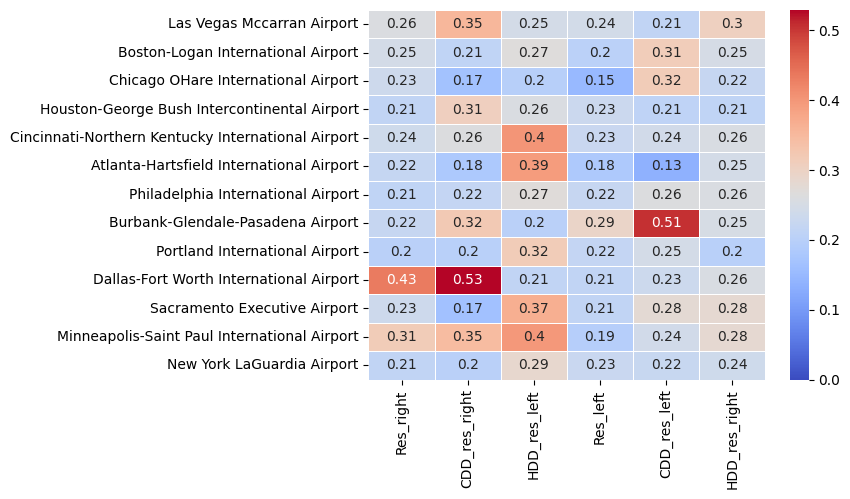

In [41]:
df_evi_all = pd.DataFrame(
    {
        # "CDD": df_evi_cdd.median(axis=0),
        # "HDD": df_evi_hdd.median(axis=0),
        # * due to temp obs >> temp expected
        "Res_right": df_evi_res_right.median(axis=0),  # all seasons
        "CDD_res_right": df_evi_cdd_res_right.median(axis=0),  # summer
        "HDD_res_left": df_evi_hdd_res_left.median(axis=0),  # winter
        # * due to temp obs << temp expected
        "Res_left": df_evi_res_left.median(axis=0),  # all seasons
        "CDD_res_left": df_evi_cdd_res_left.median(axis=0),  # summer
        "HDD_res_right": df_evi_hdd_res_right.median(axis=0),  # winter
    }
)
sns.heatmap(df_evi_all, annot=True, cmap="coolwarm", linewidths=0.5, vmin=0)

plt.savefig("heatmap.svg", format='svg')

In [42]:
df_evi_all.describe()



,Res_right,CDD_res_right,HDD_res_left,Res_left,CDD_res_left,HDD_res_right
count,13.000000,13.000000,13.000000,13.000000,13.000000,13.000000
mean,0.249577,0.266607,0.293800,0.216750,0.263000,0.250555
std,0.061996,0.103662,0.074986,0.033257,0.086384,0.028935
min,0.202549,0.165309,0.197599,0.150353,0.134510,0.200325
25%,0.214689,0.200424,0.245084,0.204038,0.224558,0.236406
50%,0.234776,0.218985,0.270813,0.217290,0.241416,0.250409
75%,0.245331,0.320482,0.367810,0.226059,0.278547,0.258125
max,0.432787,0.529248,0.401735,0.293775,0.505201,0.304781


/tmp/ipykernel_1879/2742377492.py:5: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  description = description.applymap(lambda x: f'{x:.6f}')


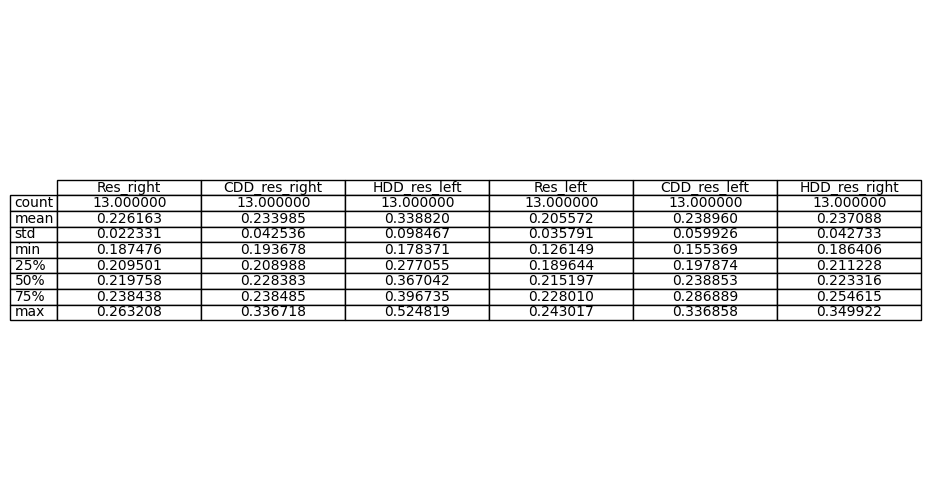

In [ ]:
# Get the description of the DataFrame
description = df_evi_all.describe()

# Format the values to 6 decimal places
description = description.applymap(lambda x: f'{x:.6f}')

# Create a figure and axis
fig, ax = plt.subplots(figsize=(12, 8))  # Adjust the size as needed

# Hide the axes
ax.xaxis.set_visible(False)
ax.yaxis.set_visible(False)
ax.set_frame_on(False)

# Create a table
table = ax.table(cellText=description.values, colLabels=description.columns, rowLabels=description.index, cellLoc='center', loc='center')

# Adjust the table properties
table.auto_set_font_size(False)
table.set_fontsize(9)
table.scale(1.2, 1.2)

# Adjust layout to fit the table within the figure area
plt.subplots_adjust(left=0.2, right=0.8, top=0.8, bottom=0.2)

# Save the table as an SVG file
svg_file_path = 'df_evi_all_description.svg'
plt.savefig(svg_file_path, format='svg')

# Show the plot (optional)
plt.show()

# TDC, tail dep coeff


In [44]:
def ferreira_tail_dep_coeff(x: torch.Tensor, y: torch.Tensor) -> float:
    """pairwise tail dependence coefficient (λ) estimator, max of rotation 0, 90, 180, 270
    x and y are both of shape (n, 1) inside (0, 1)
    symmetric for (x,y), (y,1-x), (1-x,1-y), (1-y,x), (y,x), (1-x,y), (1-y,1-x), (x,1-y)
    Ferreira, M.S., 2013. Nonparametric estimation of the tail-dependence coefficient;
    """
    x1 = 1 - x
    y1 = 1 - y
    return (
        3
        - (
            1
            - torch.as_tensor(
                [
                    torch.max(x, y).mean(),
                    torch.max(y, x1).mean(),
                    torch.max(x1, y1).mean(),
                    torch.max(y1, x).mean(),
                ]
            )
            .clamp(0.5, 0.6666666666666666)
            .min()
        ).reciprocal()
    ).item()

## CDD Residual TDC: CDD - CDD_pred


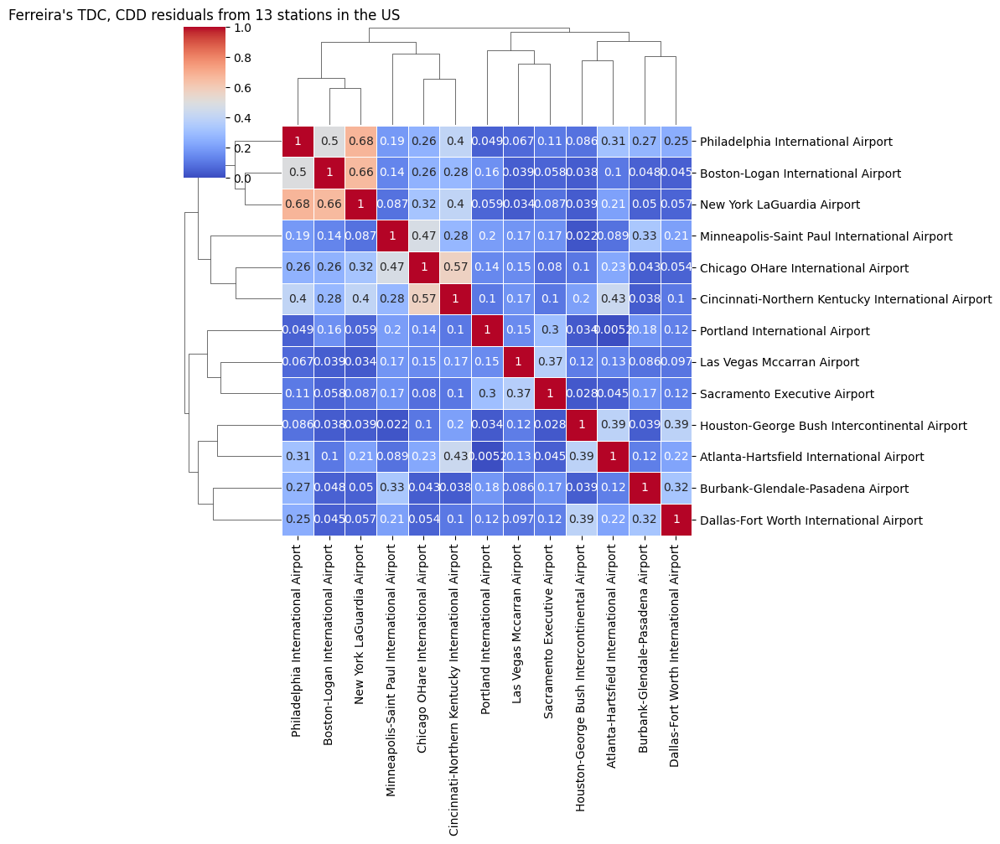

In [45]:
df_cop = df_cdd_res.apply(lambda vec: unibm.cdf_func_kernel(vec)(vec))
df_tdc_cdd_res = df_cop.corr(
    method=lambda x, y: ferreira_tail_dep_coeff(torch.tensor(x), torch.tensor(y))
)
g = sns.clustermap(
    df_tdc_cdd_res,
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=0,
    vmax=1,
)
plt.title("Ferreira's TDC, CDD residuals from 13 stations in the US")

plt.savefig("Ferreira_TDC_CDD_residuals.svg", format='svg')

## HDD Residual TDC: HDD - HDD_pred


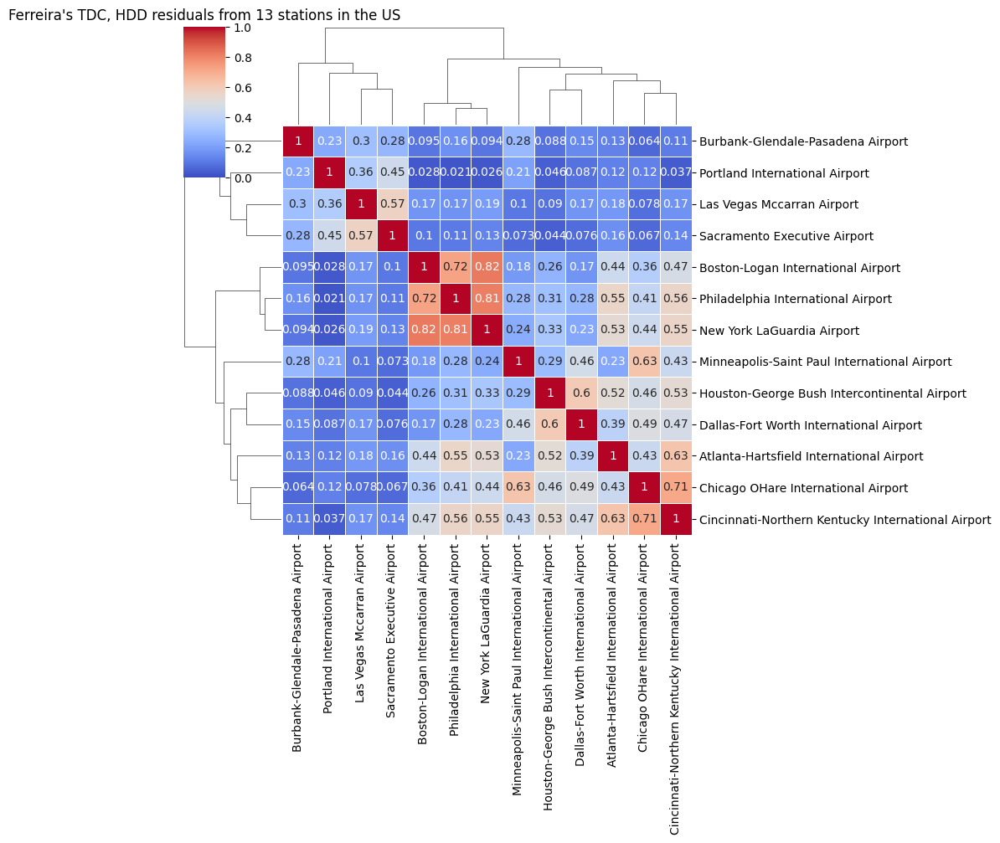

In [46]:
df_cop = df_hdd_res.apply(lambda vec: unibm.cdf_func_kernel(vec)(vec))
df_tdc_hdd_res = df_cop.corr(
    method=lambda x, y: ferreira_tail_dep_coeff(torch.tensor(x), torch.tensor(y))
)
g = sns.clustermap(
    df_tdc_hdd_res,
    annot=True,
    cmap="coolwarm",
    linewidths=0.5,
    vmin=0,
    vmax=1,
)
plt.title("Ferreira's TDC, HDD residuals from 13 stations in the US")

plt.savefig("Ferreira_TDC_HDD_residuals.svg", format='svg')

In [47]:
tmp = df_tdc_cdd_res.melt().value
tmp = tmp[tmp < 1]
tmp.describe()

count    156.000000
mean       0.182215
std        0.150877
min        0.005236
25%        0.058941
50%        0.132550
75%        0.260605
max        0.675474
Name: value, dtype: float64

In [48]:
tmp = df_tdc_hdd_res.melt().value
tmp = tmp[tmp < 1]
tmp.describe()

count    156.000000
mean       0.288874
std        0.206254
min        0.020871
25%        0.111835
50%        0.229670
75%        0.446904
max        0.821632
Name: value, dtype: float64

# IO


In [41]:
import pickle

dct_all = {
    #
    "df_avg_all": df_avg_all,
    "df_max_all": df_max_all,
    "df_min_all": df_min_all,
    #
    "dct_fit_res": dct_fit_res,
    "df_y": df_y,
    "df_y_pred": df_y_pred,
    "df_res": df_res,
    "df_std": df_std,
    "df_res_scaled": df_res_scaled,
    #
    "df_cdd": df_cdd,
    "df_cdd_pred": df_cdd_pred,
    "df_cdd_res": df_cdd_res,
    "df_hdd": df_hdd,
    "df_hdd_pred": df_hdd_pred,
    "df_hdd_res": df_hdd_res,
    #
    "df_evi_all": df_evi_all,
}
file_out = DIR_WORK / "out" / "res_CDD_HDD.pkl"
file_out.parent.mkdir(parents=True, exist_ok=True)
pickle.dump(dct_all, open(file_out, "wb"))